<a href="https://colab.research.google.com/github/gizdatalab/SDG_11_Tracking_Colombia/blob/main/Visualisation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install & Import

In [1]:
%%capture
!pip install earthengine-api
!pip install geemap 
!pip install geopandas 
!pip install mapclassify
!pip install geojson

In [2]:
# Import, authenticate and initialize the Earth Engine library.
import ee
import geemap
import geopandas as gpd
try:
    ee.Initialize()
except Exception as e:
    ee.Authenticate()
    ee.Initialize()
  
import mapclassify
mapclassify.__version__

To authorize access needed by Earth Engine, open the following URL in a web browser and follow the instructions. If the web browser does not start automatically, please manually browse the URL below.

    https://accounts.google.com/o/oauth2/auth?client_id=517222506229-vsmmajv00ul0bs7p89v5m89qs8eb9359.apps.googleusercontent.com&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fearthengine+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdevstorage.full_control&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&response_type=code&code_challenge=sxSwGgJtMRz5pzkV_ayuTWUqW4bLZI5CKvsjxe-iJdc&code_challenge_method=S256

The authorization workflow will generate a code, which you should paste in the box below. 
Enter verification code: 4/1AY0e-g7GTGAN3aMsLopAI3-iyvXq1Dz8J8O9yrt-CweTnamSCtWVl8YAHhc

Successfully saved authorization token.


'2.4.2'

# Area of Interest

In [3]:
# specify the area of interest - country boundaries colombia from the FAO datase
#bogota
x = -74.08 #- 75.6
y = 4.68 #6.22
#medellin
x = - 75.6
y = 6.22

AOI = ee.Geometry.Point(x,y);
adminArea = ee.FeatureCollection("FAO/GAUL/2015/level2")\
                        .filterBounds(AOI) 
   


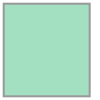

In [205]:
from shapely.geometry import Polygon

a = [[-74.315, 4.417],
 [-73.827, 4.417],
 [-73.827, 4.8874],
 [-74.315, 4.8874]]
bogota_aoi = Polygon(a)
bogota_aoi

a = [[-75.653, 6.174],
 [-75.51, 6.174],
 [-75.51, 6.328],
 [-75.653, 6.328]]

#a = [[-75.575, 6.28],
# [-75.553, 6.28],
# [-75.553, 6.308],
# [-75.575, 6.308]]

medellin_aoi = Polygon(a)
medellin_aoi


In [206]:
from geojson import Point,Polygon, Feature, FeatureCollection, dump


#medellin_aoi
features = []
features.append(Feature(geometry=medellin_aoi, properties={"country": "medellin"}))

feature_collection = FeatureCollection(features)

with open('myfile.geojson', 'w') as f:
    dump(feature_collection, f)
geojson = gpd.read_file('myfile.geojson')

In [207]:
import numpy as np
shell_coords = np.array(geojson['geometry'].exterior[0])

footprint = []
for i in shell_coords[:4]:
    footprint.append([a for a in i])

aoi = ee.Geometry.Polygon(footprint)

footprint

[[-75.653, 6.174], [-75.51, 6.174], [-75.51, 6.328], [-75.653, 6.328]]

In [208]:
adminArea_new = ee.Feature(aoi).intersection(adminArea.first(), 10)

In [209]:
neighborhoods = ee.FeatureCollection("users/eriklehmann91/medellin_neighborhoods")\
                                   # .filter(ee.Filter.eq("name",'Comuna 1 - Popular'))  #Comuna 14 - El Poblado

In [210]:
med = ee.FeatureCollection("users/eriklehmann91/MGN_URB_AREA_CENSAL").filterBounds(AOI)

In [211]:
parcels = ee.FeatureCollection("users/eriklehmann91/MGN_URB_MANZANA")\
                        .filterBounds(aoi)#.filterBounds(neighborhoods)    

In [212]:
AOI_level = parcels
AOI_pixel = 240

In [213]:
# plot zones
Map = geemap.Map(center=[y,x], zoom=12)
Map.add_basemap('ESRI')
Map.addLayer(adminArea, {}, 'area of interest2',False);
Map.addLayer(aoi, {}, 'aoi',False);
Map.addLayer(med, {}, 'amed');
Map.addLayer(parcels, {}, 'parcels');
Map.addLayer(neighborhoods, {}, 'neighborhoods');
#Map.add_geojson(medellin_aoi);
Map

## Elevation

In [186]:
dataset = ee.Image('USGS/GMTED2010');
elevation = dataset.select('be75').clip(adminArea)
elevationVis = {'min': 1000.0,  'max': 3500.0,  'gamma': 3.5}


In [187]:

no = ['0: -100%','1: -75%','2: -50%','3: -25%','4: 0%','5: 25%','6: 50%','7: 75%','8: 100%']
color_pal_2 = ['e55b5b','ea7b7b','f2adad','f7cdcd','ffffff','ffe39f','ffd56f','ffc73e','ffb90f']

ld2 = dict(zip(no,color_pal_2))
elevationVisStd = {
  'min': 0,
  'max': 80,
  'palette': color_pal_2,
};

In [188]:

# Compute standard deviation (SD) as texture of the NDVI.
texture = elevation.reduceNeighborhood(reducer = ee.Reducer.stdDev(),kernel = ee.Kernel.circle(1));


In [37]:
abundance_perc = texture.multiply(1).reduceRegion(ee.Reducer.percentile([5,  50, 95]), AOI_level, 200)
print(abundance_perc.getInfo())

{'be75_stdDev_p5': 2.2925738207882773, 'be75_stdDev_p50': 16.231293036156213, 'be75_stdDev_p95': 48.26621636529873}


In [ ]:


Map = geemap.Map(center=[y,x], zoom=12)
Map.add_basemap('Esri Shaded Relief')

Map.addLayer(elevation, elevationVis, 'Elevation');
#Map.addLayer(parcels, {}, 'area of interest');
Map.addLayer(texture, elevationVisStd, 'SD of NDVI')
#Map.add_shapefile(bogota_aoi, {});
Map

In [189]:
elevation_agg = elevation.rename('elevation').reduceRegions(collection= AOI_level,reducer=ee.Reducer.mean(), scale= AOI_pixel)

In [190]:
geemap.ee_to_shp(elevation_agg, 'medellin_parcels_elevation.shp', selectors=None, verbose=True, keep_zip=False) 

KeyboardInterrupt: ignored

In [ ]:
import geopandas as gpd
gdf_elev = gpd.read_file('medellin_parcels_elevation.shp')

pip_mask = gdf_elev.within(medellin_aoi)
gdf_elev_aoi = gdf_elev.loc[pip_mask].copy()

print(gdf_elev.shape,gdf_elev_aoi.shape)

(-75.6447057091541, -75.51564504764828, 6.168440119079672, 6.319695974571951)

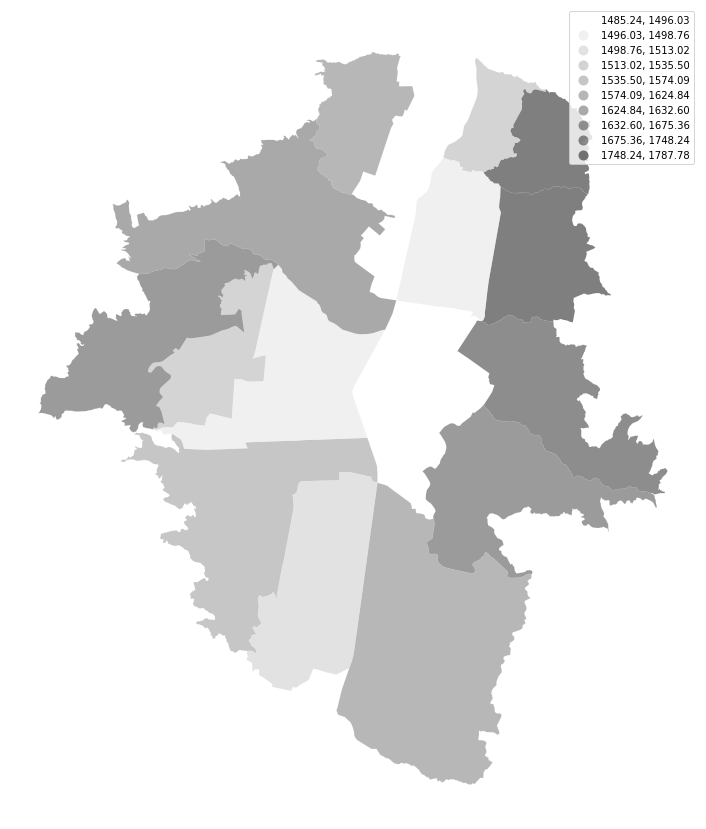

In [41]:
figs = 15
plt = gdf_elev_aoi.plot(figsize=(figs, figs), alpha=0.5, edgecolor='white', linewidth=.1,column='mean', scheme='QUANTILES', k=10, cmap='gray_r', legend=True)
plt.set_label('elevation')
#plt.legend(loc="upper right")
plt.axis('off')

In [ ]:
from google.colab import files
plt.figure.savefig('medellin_elevation.png')
files.download('medellin_elevation.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Elevation Std

In [ ]:
texture_agg = texture.rename('texture').reduceRegions(collection= parcels,reducer=ee.Reducer.mean(), scale= 200)

In [ ]:
geemap.ee_to_shp(texture_agg, 'medellin_parcels_texture_agg.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
An error occurred while downloading. 
 Retrying ...
Generating URL ...
Please wait ...
Data downloaded to /content/medellin_parcels_texture_agg.shp


In [ ]:
import geopandas as gpd
gdf_texture = gpd.read_file('medellin_parcels_texture_agg.shp')

pip_mask = gdf_texture.within(medellin_aoi)
gdf_texture_aoi = gdf_texture.loc[pip_mask].copy()

print(gdf_texture.shape,gdf_texture_aoi.shape)

(12862, 12) (12862, 12)


(-75.647372074752, -75.50762335914223, 6.16678560928925, 6.315005213855621)

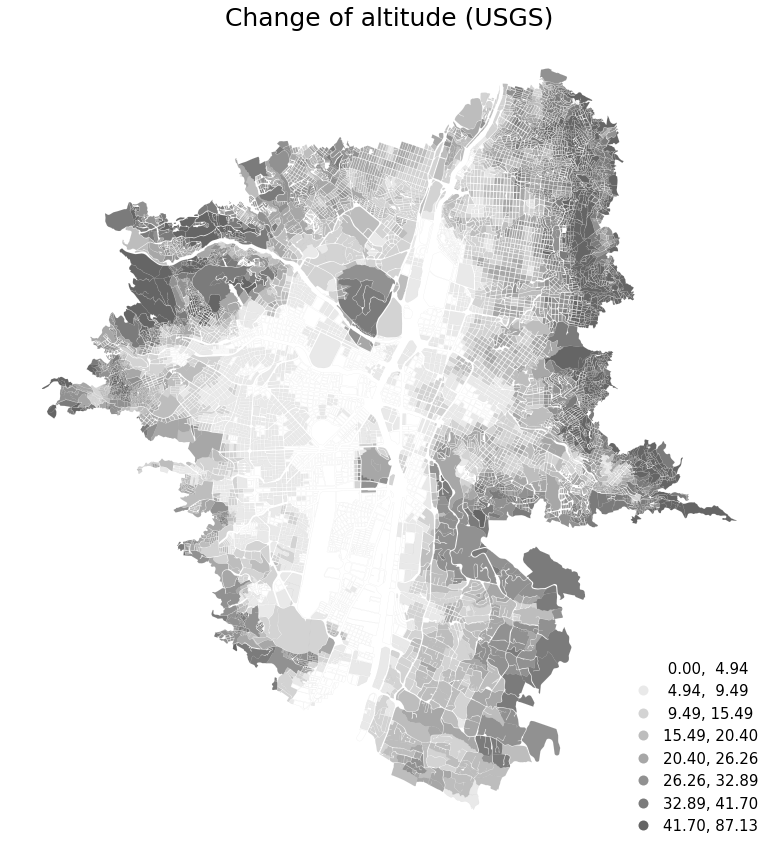

In [ ]:
figs = 15
plt = gdf_texture_aoi.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#aaaaaa', #'#0e6b52',
                             linewidth=.1,
                             column='mean',
                             scheme='QUANTILES',
                             k=8,
                             #hatch='.',
                             cmap='gray_r', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Change of altitude (USGS)", fontsize=25)
plt.axis('off')

(-75.6447057091541, -75.51564504764828, 6.168440119079672, 6.319695974571951)

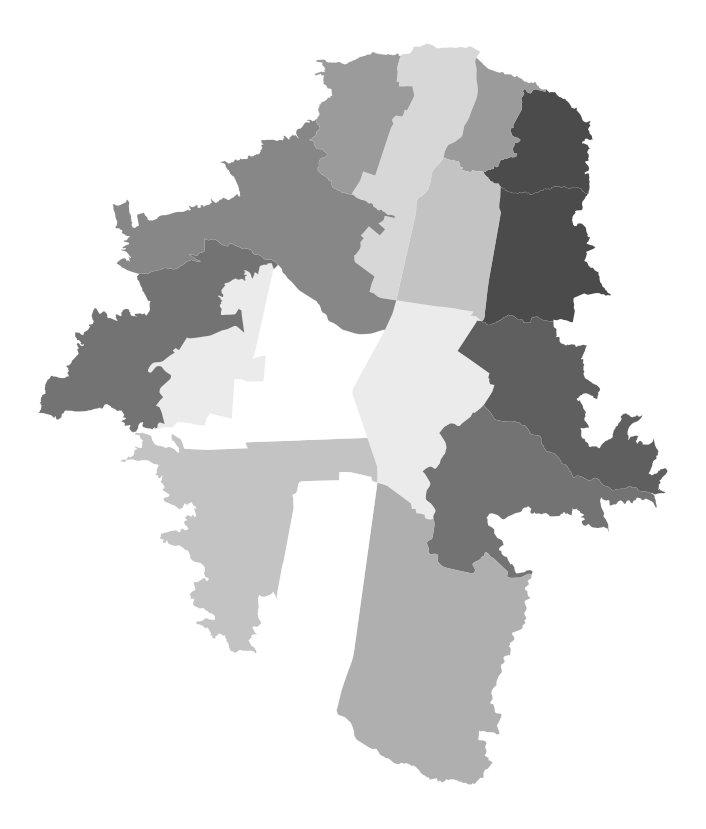

In [ ]:
figs = 15
plt = gdf_texture_aoi.plot(figsize=(figs, figs), alpha=0.7, edgecolor='white', linewidth=.1,column='mean', scheme='QUANTILES', k=10, cmap='gray_r')#, legend=True)
plt.set_label('elevation')
#plt.legend(loc="upper right")
plt.axis('off')

In [ ]:
from google.colab import files
plt.figure.savefig('medellin_elevation_std.png')
files.download('medellin_elevation_std.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Sentinel Image

### 1990

In [ ]:
abundance_perc = colorized.multiply(100).reduceRegion(ee.Reducer.percentile([5,  50, 95]), adminArea, 200)
print(abundance_perc.getInfo())

{'NDVI_p5': 20.674909637546833, 'NDVI_p50': 25.694575418646515, 'NDVI_p95': 35.70970382009234}


In [ ]:
dataset = ee.ImageCollection('LANDSAT/LT05/C01/T1_ANNUAL_NDVI')\
                  .filterDate('1988-01-01', '1994-12-31')\
                  .filterBounds(neighborhoods)

  
colorized = dataset.select('NDVI').median()
colorized =colorized.mask(colorized.gt(.2))
colorizedVis = {
  min: 0.0,
  max: 1.0,
  'palette': [
    'CE7E45',
    '66A000', '662E33','22AE33', 
    '012E01', 
  ],
};
Map = geemap.Map(center=[y,x], zoom=13)
Map.setCenter(-75.6, 6.2529, 10);
Map.addLayer(colorized, colorizedVis, 'Colorized');
Map

In [ ]:
gdf_gps_1990 = colorized.unmask().rename('ndvi').reduceRegions(collection= parcels,reducer=ee.Reducer.mean(), scale= 200)
geemap.ee_to_shp(gdf_gps_1990, 'medellin_parcels_green_1990.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
Data downloaded to /content/medellin_parcels_green_1990.shp


In [ ]:
import geopandas as gpd
label_df_1990= gpd.read_file('medellin_parcels_green_1990.shp') #

pip_mask = label_df_1990.within(medellin_aoi)
gdf_aoi_1990 = label_df_1990.loc[pip_mask].copy()

print(label_df_1990.shape,gdf_aoi_1990.shape)

(16, 6) (16, 6)


In [ ]:
gdf_aoi_1990['ndvi'] = gdf_aoi_1990['mean'] > .5

(-75.6447057091541, -75.51564504764828, 6.168440119079672, 6.319695974571951)

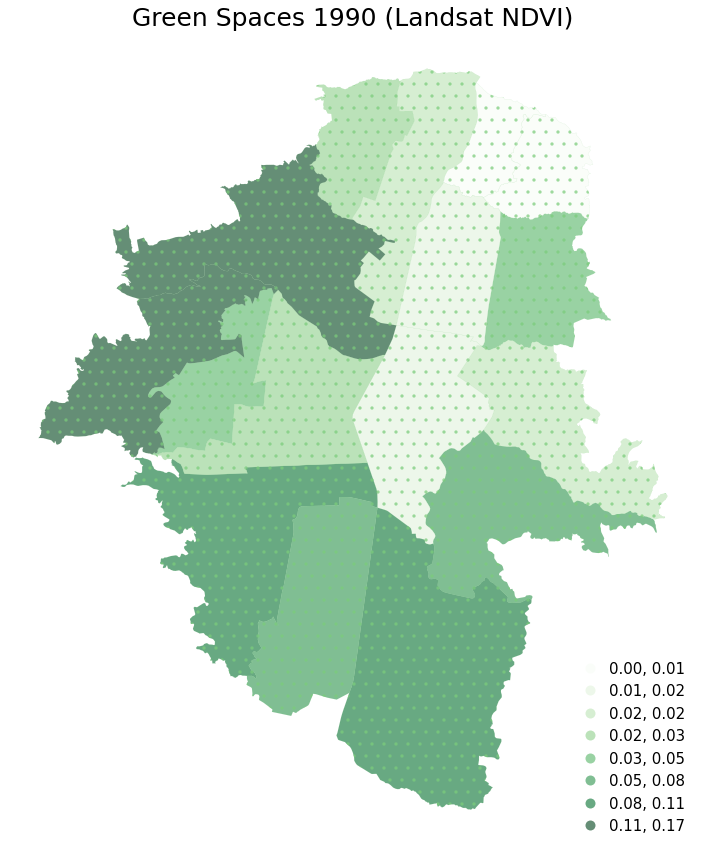

In [ ]:
figs = 15
plt = gdf_aoi_1990.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#7ccd7c', #'#0e6b52',
                             linewidth=.1,
                             column='mean',
                             scheme='QUANTILES',
                             k=8,
                             hatch='.',
                             cmap='Greens', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Green Spaces 1990 (Landsat NDVI)", fontsize=25)
plt.axis('off')

### 2015

In [ ]:
dataset = ee.ImageCollection('LANDSAT/LT05/C01/T1_ANNUAL_NDVI')\
                  .filterDate('2010-01-01', '2016-12-31')\
                  .filterBounds(adminArea)

  
colorized = dataset.select('NDVI').median()
colorized =colorized.mask(colorized.gt(.2))
colorizedVis = {
  min: 0.0,
  max: 1.0,
  'palette': [
    'CE7E45',
    '66A000', '662E33','22AE33', 
    '012E01', 
  ],
};
Map = geemap.Map(center=[y,x], zoom=13)
Map.setCenter(-75.6, 6.2529, 10);
Map.addLayer(colorized, colorizedVis, 'Colorized');
Map

In [ ]:
gdf_gps_2015 = colorized.unmask().rename('ndvi').reduceRegions(collection= parcels,reducer=ee.Reducer.mean(), scale= 200)
geemap.ee_to_shp(gdf_gps_2015, 'medellin_parcels_green_2015.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
Data downloaded to /content/medellin_parcels_green_2015.shp


In [ ]:
import geopandas as gpd
label_df_2015 = gpd.read_file('medellin_parcels_green_2015.shp') #

pip_mask = label_df_2015.within(medellin_aoi)
gdf_aoi_2015 = label_df_2015.loc[pip_mask].copy()

print(label_df_2015.shape,gdf_aoi_2015.shape)

(16, 6) (16, 6)


In [ ]:
gdf_aoi_2015['ndvi'] = gdf_aoi_2015['mean'] > .5

(-75.6447057091541, -75.51564504764828, 6.168440119079672, 6.319695974571951)

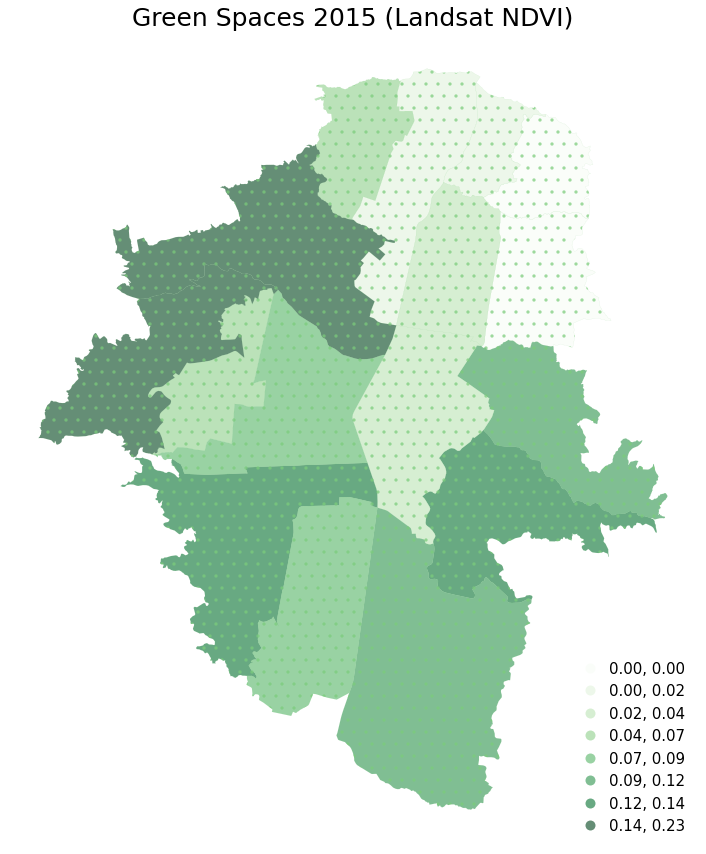

In [ ]:
figs = 15
plt = gdf_aoi_2015.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#7ccd7c', #'#0e6b52',
                             linewidth=.1,
                             column='mean',
                             scheme='QUANTILES',
                             k=8,
                             hatch='.',
                             cmap='Greens', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Green Spaces 2015 (Landsat NDVI)", fontsize=25)
plt.axis('off')

### Change


In [ ]:
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
viridis = cm.get_cmap('Greens', 256)
newcolors = viridis(np.linspace(0, 1, 256))
pink = np.array([200/256, 200/256, 200/256, 1]) # 	220,20,60
newcolors[:25, :] = pink
newgreen = ListedColormap(newcolors)

In [ ]:
df_ndvi_from_agg = gdf_aoi_1990.rename(columns={'mean':'ndvi_1990'})
df_ndvi_to_agg = gdf_aoi_2015.rename(columns={'mean':'ndvi_2015'})

df_ndvi_merge_agg = df_ndvi_to_agg[['name','ndvi_2015']].merge(df_ndvi_from_agg, on='name')

#df_bu_merge_agg = gpd.sjoin(df_bu_to_agg[['COD_DANE','bu_2021']], df_bu_from_agg, how="inner", op='overlaps')

df_ndvi_merge_agg['diff'] = df_ndvi_merge_agg['ndvi_2015']  - (df_ndvi_merge_agg['ndvi_1990'])
df_ndvi_merge_agg[:1]

,name,ndvi_2015,area,city,ndvi_1990,admin_leve,geometry,ndvi,diff
0,Comuna 12 - La Am?rica,0.063991,32.44163,Medell?n,0.029601,8,"POLYGON ((-75.61843 6.25217, -75.61821 6.25274...",False,0.03439


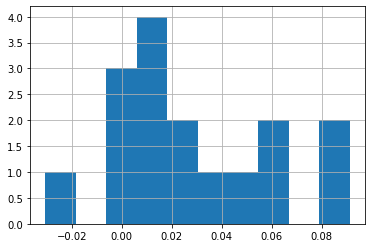

In [ ]:
df_ndvi_merge_agg['diff'].hist()

In [ ]:
import geopandas
gdf_ndvi_merge_agg = geopandas.GeoDataFrame(
    df_ndvi_merge_agg, geometry=df_ndvi_merge_agg.geometry)

gdf_ndvi_merge_agg = gdf_ndvi_merge_agg.set_crs(epsg=3857, inplace=True)

(-75.6447057091541, -75.51564504764828, 6.168440119079672, 6.319695974571951)

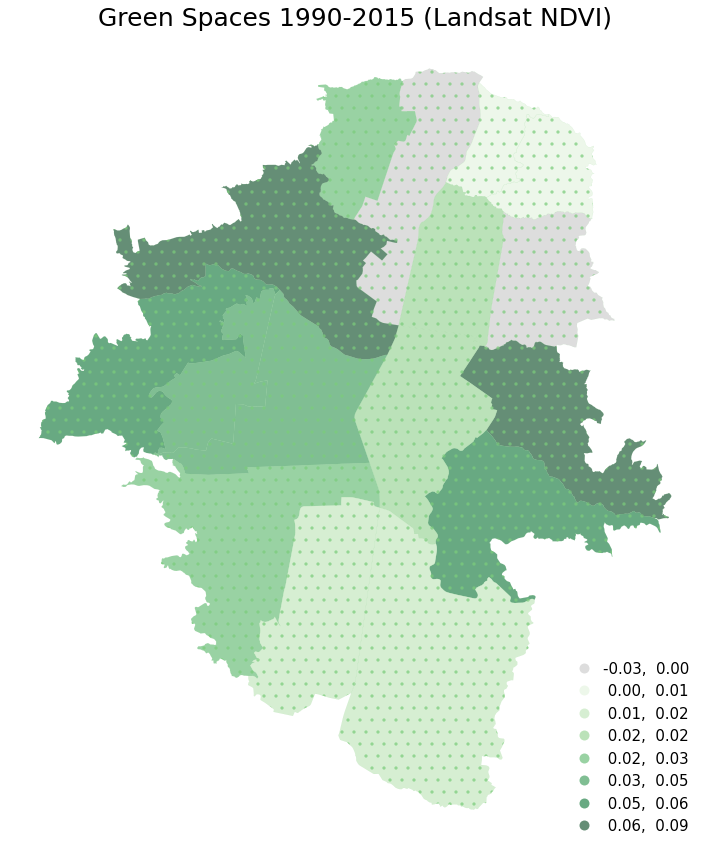

In [ ]:
figs = 15
plt = gdf_ndvi_merge_agg.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#7ccd7c', #'#0e6b52',
                             linewidth=.1,
                             column='diff',
                             scheme='QUANTILES',
                             k=8,
                             hatch='.',
                             cmap=newgreen,#'Greens', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Green Spaces 1990-2015 (Landsat NDVI)", fontsize=25)
plt.axis('off')

### 2018

In [ ]:

# maximum tolerable clou probability, pixels that have a cloud probability higher than this value will be masked
MAX_CLOUD_PROBABILITY = 15; 


#Threshold that defines "vegetation" or "green" public spaces, note that the values are scaled: NDVI * 10000
THRES = 2500; # e.g. 1500 would be an NDVI value of 0.15


#// Get the Sentinel-2 collections that are used to proxy "green" public open spaces
s2SrTMP = ee.ImageCollection('COPERNICUS/S2');

MAX_CLOUD_PROBABILITY = .3
# Parameters for the Sentinel-2 images that are used to proxy "green" public open spaces
START_DATE = ee.Date('2018-01-01');
END_DATE = ee.Date('2018-12-31');


#// The masks for the 10m bands sometimes do not exclude bad data at
def maskEdges(s2_img):
  return s2_img.updateMask(s2_img.select('B8A').mask().updateMask(s2_img.select('B9').mask()))



#// Filter input collections by desired data range and region.
criteria = ee.Filter.date(START_DATE, END_DATE)


s2Sr = s2SrTMP.filterBounds(adminArea).filter(criteria).map(maskEdges);


def maskS2clouds(image): 
  qa = image.select('QA60');

  #// Bits 10 and 11 are clouds and cirrus, respectively.
  cloudBitMask = 1 << 10;
  cirrusBitMask = 1 << 11;

  #// Both flags should be set to zero, indicating clear conditions.
  mask = qa.bitwiseAnd(cloudBitMask).eq(0).And(qa.bitwiseAnd(cirrusBitMask).eq(0));

  return image.updateMask(mask) #;//.divide(1000)

#// Add an NDVI band
#// mask out roads from OSM (otherwise, overlapping trees on roads are classified as green open public spaces)
greenPublicUrbanSpace =  ee.ImageCollection(s2Sr)\
                        .map(maskS2clouds)\
                        .median()\
                        .clip(adminArea)\
                        .normalizedDifference(['B8', 'B4'])\
                        .multiply(10000).int16()\
                        .gt(THRES)
                        #.mask(areaResidentialRoads.unmask().eq(0))\
                        #.mask(areaOtherRoads.unmask().eq(0));\


greenPublicUrbanSpace_m = greenPublicUrbanSpace.mask(greenPublicUrbanSpace.gt(0));

In [ ]:
# plot zones
Map = geemap.Map(center=[y,x], zoom=13)
# Set some visualization parameters
Map.add_basemap('ESRI')
Map.addLayer(greenPublicUrbanSpace_m, {min: 0, max: 1, 'palette':['33C68A']},'NDVI', True);
#Map.addLayer(areaOtherRoads,roadsViz, 'OtherRoads', True);

Map

In [ ]:
gdf_gps_2018 = greenPublicUrbanSpace.rename('ndvi').reduceRegions(collection= parcels,reducer=ee.Reducer.mean(), scale= 200)
geemap.ee_to_shp(gdf_gps_2018, 'medellin_parcels_green_2018.shp', selectors=None, verbose=True, keep_zip=False) 

In [ ]:
import geopandas as gpd
label_df_2018 = gpd.read_file('medellin_parcels_green_2018.shp') #

pip_mask = label_df_2018.within(medellin_aoi)
gdf_aoi_2018 = label_df_2018.loc[pip_mask].copy()

print(label_df_2018.shape,gdf_aoi_2018.shape)

(16, 6) (16, 6)


In [ ]:
gdf_aoi_2018['ndvi'] = gdf_aoi_2018['mean'] > .5

No handles with labels found to put in legend.


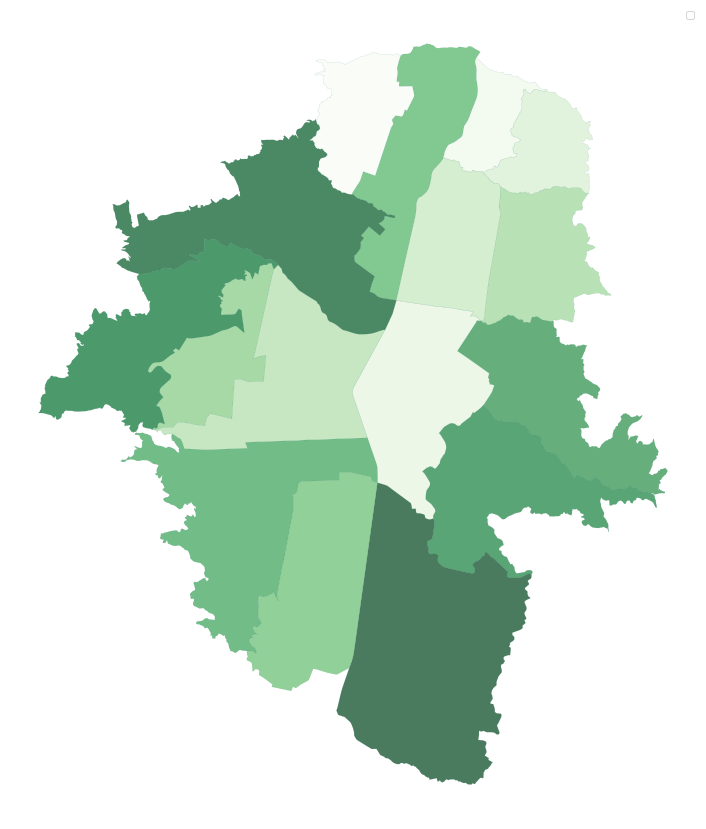

In [ ]:
figs = 15
plt = gdf_aoi_2018.plot(figsize=(figs, figs), alpha=0.7, edgecolor='#0e6b52', linewidth=.1,column='mean', scheme='QUANTILES', k=100, cmap='Greens', legend=True)
plt.axis('off')
plt.legend(loc="upper right")
#plt.gca().set_position([0, 0, 1, 1])

In [ ]:
from google.colab import files
plt.figure.savefig('medellin_ndvi_2018.png')
files.download('medellin_ndvi_2018.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
df_ndvi_merge_agg['COD_DANE'].value_counts()

0500110000000014140137    1
0500110000000016150620    1
0500110000000090590438    1
0500110000000007140126    1
0500120020601000010110    1
                         ..
0500110000000090610507    1
0500110000000002070103    1
0500110000000014190309    1
0500110000000005140110    1
0500110000000013060925    1
Name: COD_DANE, Length: 12531, dtype: int64

### Now

In [ ]:

# maximum tolerable clou probability, pixels that have a cloud probability higher than this value will be masked
MAX_CLOUD_PROBABILITY = 15; 


#Threshold that defines "vegetation" or "green" public spaces, note that the values are scaled: NDVI * 10000
THRES = 2500; # e.g. 1500 would be an NDVI value of 0.15


#// Get the Sentinel-2 collections that are used to proxy "green" public open spaces
s2SrTMP = ee.ImageCollection('COPERNICUS/S2');

MAX_CLOUD_PROBABILITY = .3
# Parameters for the Sentinel-2 images that are used to proxy "green" public open spaces
START_DATE = ee.Date('2021-01-01');
END_DATE = ee.Date('2021-12-31');


#// The masks for the 10m bands sometimes do not exclude bad data at
def maskEdges(s2_img):
  return s2_img.updateMask(s2_img.select('B8A').mask().updateMask(s2_img.select('B9').mask()))



#// Filter input collections by desired data range and region.
criteria = ee.Filter.date(START_DATE, END_DATE)


s2Sr = s2SrTMP.filterBounds(adminArea).filter(criteria).map(maskEdges);


def maskS2clouds(image): 
  qa = image.select('QA60');

  #// Bits 10 and 11 are clouds and cirrus, respectively.
  cloudBitMask = 1 << 10;
  cirrusBitMask = 1 << 11;

  #// Both flags should be set to zero, indicating clear conditions.
  mask = qa.bitwiseAnd(cloudBitMask).eq(0).And(qa.bitwiseAnd(cirrusBitMask).eq(0));

  return image.updateMask(mask) #;//.divide(1000)

#// Add an NDVI band
#// mask out roads from OSM (otherwise, overlapping trees on roads are classified as green open public spaces)
greenPublicUrbanSpace =  ee.ImageCollection(s2Sr)\
                        .map(maskS2clouds)\
                        .median()\
                        .clip(neighborhoods)\
                        .normalizedDifference(['B8', 'B4'])\
                        .multiply(10000).int16()\
                        .gt(THRES)
                        #.mask(areaResidentialRoads.unmask().eq(0))\
                        #.mask(areaOtherRoads.unmask().eq(0));\


greenPublicUrbanSpace_m = greenPublicUrbanSpace.mask(greenPublicUrbanSpace.gt(0));

In [ ]:
# plot zones
Map = geemap.Map(center=[y,x], zoom=13)
# Set some visualization parameters
Map.add_basemap('ESRI')
Map.addLayer(greenPublicUrbanSpace_m, {min: 0, max: 1, 'palette':['33C68A']},'NDVI', True);
#Map.addLayer(areaOtherRoads,roadsViz, 'OtherRoads', True);

Map

In [ ]:
gdf_gps = greenPublicUrbanSpace.rename('ndvi').reduceRegions(collection= parcels,reducer=ee.Reducer.mean(), scale= 200)

In [ ]:
geemap.ee_to_shp(gdf_gps, 'medellin_parcels_green.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
Data downloaded to /content/medellin_parcels_green.shp


In [ ]:
import geopandas as gpd
label_df = gpd.read_file('medellin_parcels_green.shp')

pip_mask = label_df.within(medellin_aoi)
gdf_aoi = label_df.loc[pip_mask].copy()

print(label_df.shape,gdf_aoi.shape)

(16, 6) (16, 6)


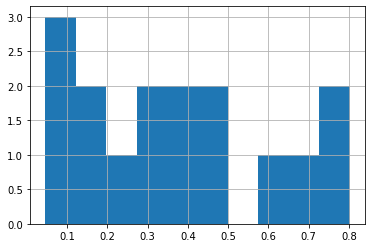

In [ ]:
gdf_aoi['mean'].hist()

In [ ]:
gdf_aoi['ndvi'] = gdf_aoi['mean'] > .5

(-75.6447057091541, -75.51564504764828, 6.168440119079672, 6.319695974571951)

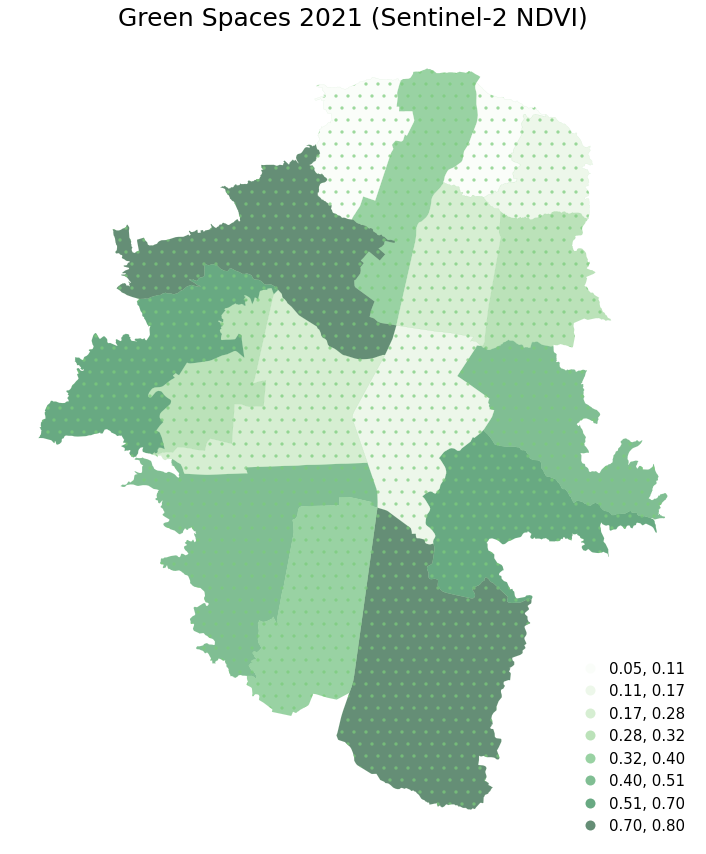

In [ ]:
figs = 15
plt = gdf_aoi.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#7ccd7c', #'#0e6b52',
                             linewidth=.1,
                             column='mean',
                             scheme='QUANTILES',
                             k=8,
                             hatch='.',
                             cmap='Greens', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Green Spaces 2021 (Sentinel-2 NDVI)", fontsize=25)
plt.axis('off')

/usr/local/lib/python3.7/dist-packages/mapclassify/classifiers.py:235: UserWarning: Warning: Not enough unique values in array to form k classes
  "Warning: Not enough unique values in array to form k classes", UserWarning
/usr/local/lib/python3.7/dist-packages/mapclassify/classifiers.py:237: UserWarning: Warning: setting k to 15
  Warn("Warning: setting k to %d" % k_q, UserWarning)
No handles with labels found to put in legend.


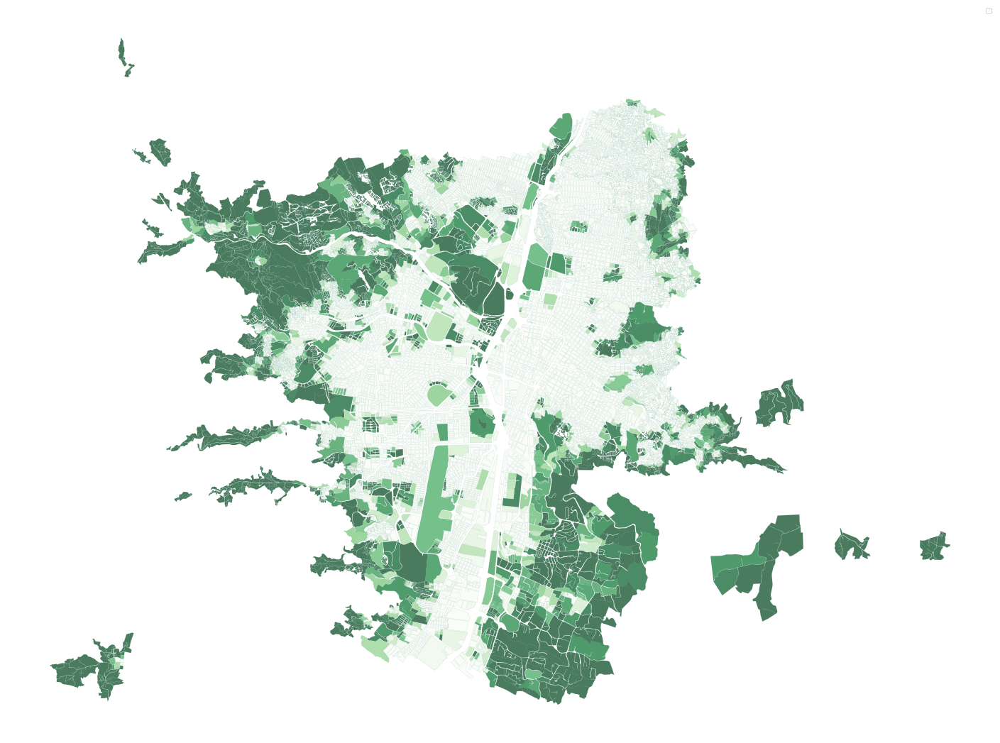

In [ ]:
figs = 25
plt = gdf_aoi.plot(figsize=(figs, figs), alpha=0.7, edgecolor='#0e6b52', linewidth=.1,column='mean', scheme='QUANTILES', k=100, cmap='Greens', legend=True)
plt.axis('off')
plt.legend(loc="upper right")
#plt.gca().set_position([0, 0, 1, 1])

In [ ]:
from google.colab import files
plt.figure.savefig('medellin_ndvi_2021.png')
files.download('medellin_ndvi_2021.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Change


In [ ]:
df_ndvi_from_agg = gdf_aoi_2018.rename(columns={'mean':'ndvi_2018'})
df_ndvi_to_agg = gdf_aoi.rename(columns={'mean':'ndvi_2021'})

df_ndvi_merge_agg = df_ndvi_to_agg[['COD_RDTM','ndvi_2021']].merge(df_ndvi_from_agg, on='COD_RDTM')

#df_bu_merge_agg = gpd.sjoin(df_bu_to_agg[['COD_DANE','bu_2021']], df_bu_from_agg, how="inner", op='overlaps')

df_ndvi_merge_agg['diff'] = df_ndvi_merge_agg['ndvi_2021']  - (df_ndvi_merge_agg['ndvi_2018'])
df_ndvi_merge_agg[:1]

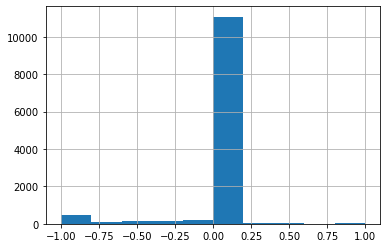

In [ ]:
df_ndvi_merge_agg['diff'].hist()

In [ ]:
import geopandas
gdf_ndvi_merge_agg = geopandas.GeoDataFrame(
    df_ndvi_merge_agg, geometry=df_ndvi_merge_agg.geometry)

gdf_ndvi_merge_agg = gdf_ndvi_merge_agg.set_crs(epsg=3857, inplace=True)

/usr/local/lib/python3.7/dist-packages/mapclassify/classifiers.py:235: UserWarning: Warning: Not enough unique values in array to form k classes
  "Warning: Not enough unique values in array to form k classes", UserWarning
/usr/local/lib/python3.7/dist-packages/mapclassify/classifiers.py:237: UserWarning: Warning: setting k to 10
  Warn("Warning: setting k to %d" % k_q, UserWarning)


(-75.68313646313652, -75.46907203446717, 6.168560297017044, 6.3261975273422095)

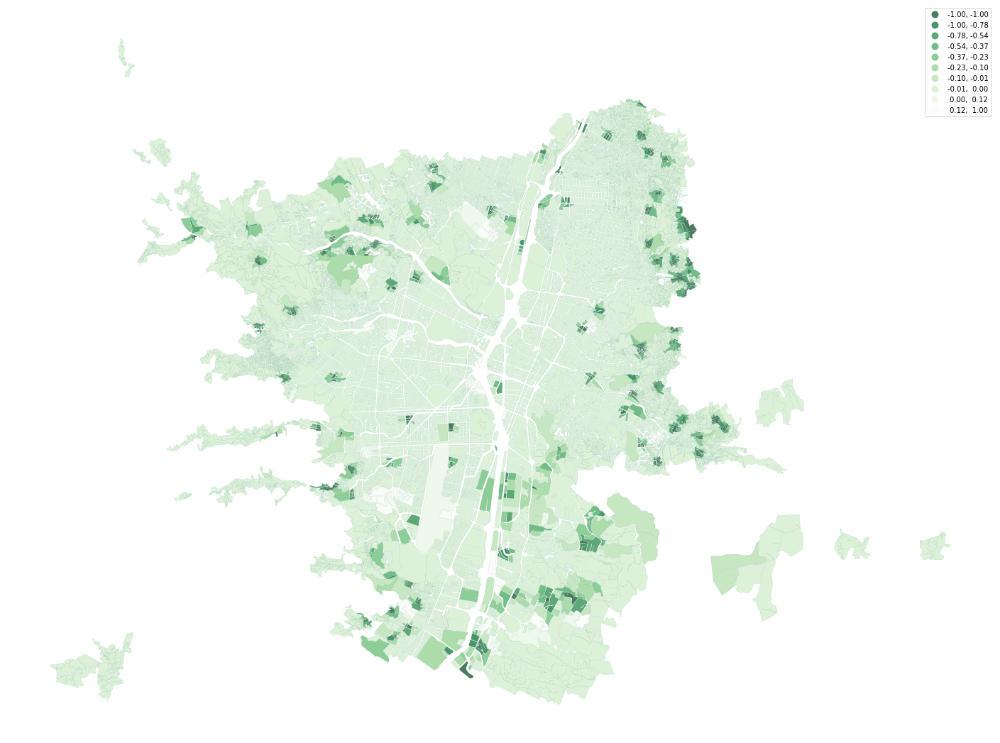

In [ ]:
figs = 25
plt = gdf_ndvi_merge_agg.plot(figsize=(figs, figs), alpha=0.7, edgecolor='#0e6b52', linewidth=.1,column='diff', scheme='QUANTILES', k=100, cmap='Greens_r', legend=True)
plt.set_label('build up percentage')
#plt.legend(loc="upper right")
plt.axis('off')

In [ ]:
from google.colab import files
plt.figure.savefig('medellin_ndvi_2018_2021.png')
files.download('medellin_ndvi_2018_2021.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Build up

### 1990

In [16]:
# Built-up area from the Global Human Settlement Layer opf the JRC
builtUpGHSL = ee.Image("JRC/GHSL/P2016/BUILT_LDSMT_GLOBE_V1").select('built')#.clip(adminArea)
# select the Multitemporal built-up presence layer

# get the area that was built-up in 2000 from the "Multitemporal built-up presence" layer = past period                
TotalBuiltUp_2015 = builtUpGHSL.gte(3).updateMask(builtUpGHSL.gte(3))
TotalBuiltUp_2000 = builtUpGHSL.gte(4).updateMask(builtUpGHSL.gte(4))
TotalBuiltUp_1990 = builtUpGHSL.gte(5).updateMask(builtUpGHSL.gte(5))
TotalBuiltUp_1975 = builtUpGHSL.eq(6).updateMask(builtUpGHSL.eq(6))


In [181]:
# plot zones
Map = geemap.Map(center=[y,x], zoom=13)
# Set some visualization parameters
Map.add_basemap('ESRI')
#Map.addLayer(TotalBuiltUp_1975, {min: 0, max: 1, 'palette':['ffffff','33C68A']},'BU', False);

Map.addLayer(TotalBuiltUp_2015, {min: 0, max: 1, 'palette':['ffffff','AA4682']},'BU15', True);
Map.addLayer(TotalBuiltUp_2000, {min: 0, max: 1, 'palette':['ffffff','33C68A']},'BU00', True);
Map.addLayer(TotalBuiltUp_1990, {min: 0, max: 1, 'palette':['ffffff','334682']},'BU90', True);

#Map.addLayer(areaOtherRoads,roadsViz, 'OtherRoads', True);

Map

In [369]:
TotalBuiltUp_1990 = builtUpGHSL.gte(5).rename('1990').addBands(builtUpGHSL.gte(1).rename('total'))
TotalBuiltUp_1990_area = TotalBuiltUp_1990.multiply(ee.Image.pixelArea())#.divide(1000000)

In [368]:
#abundance_perc = TotalBuiltUp_1990.multiply(100).reduceRegion(ee.Reducer.percentile([5,  50, 95]), AOI_level, AOI_pixel)
#print(abundance_perc.getInfo())

In [401]:
bu_from_agg = TotalBuiltUp_1990_area.reduceRegions(collection= AOI_level,reducer=ee.Reducer.sum(),scale=AOI_pixel )
#bu_to_agg = bu_to.rename('bu').reduceRegions(collection= parcels,reducer=ee.Reducer.mean(), scale= 200)

In [402]:
#bu_from_agg.reduceColumns(reducer= ee.Reducer.percentile([5,  50, 95]),selectors=['1990']).getInfo()

In [ ]:
geemap.ee_to_shp(bu_from_agg, 'bu_from_agg.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
An error occurred while downloading. 
 Retrying ...
Generating URL ...
Please wait ...


In [ ]:
df_bu_from_agg = gpd.read_file('bu_from_agg.shp')
pip_mask = df_bu_from_agg.within(medellin_aoi)
gdf_bu_from_agg = df_bu_from_agg.loc[pip_mask].copy()
print(df_bu_from_agg.shape,gdf_bu_from_agg.shape)

In [ ]:
gdf_bu_from_agg['1990'].hist()

In [ ]:
gdf_bu_from_agg['mean'] = gdf_bu_from_agg['1990'] / (gdf_bu_from_agg['total'] +1)

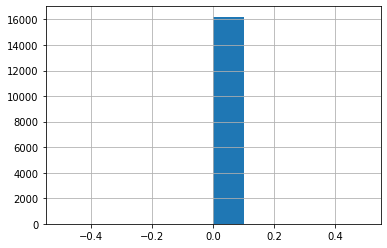

In [400]:
gdf_bu_from_agg['mean'].hist()

(-75.66011035656898, -75.5033217358933, 6.166306199889512, 6.335666505588572)

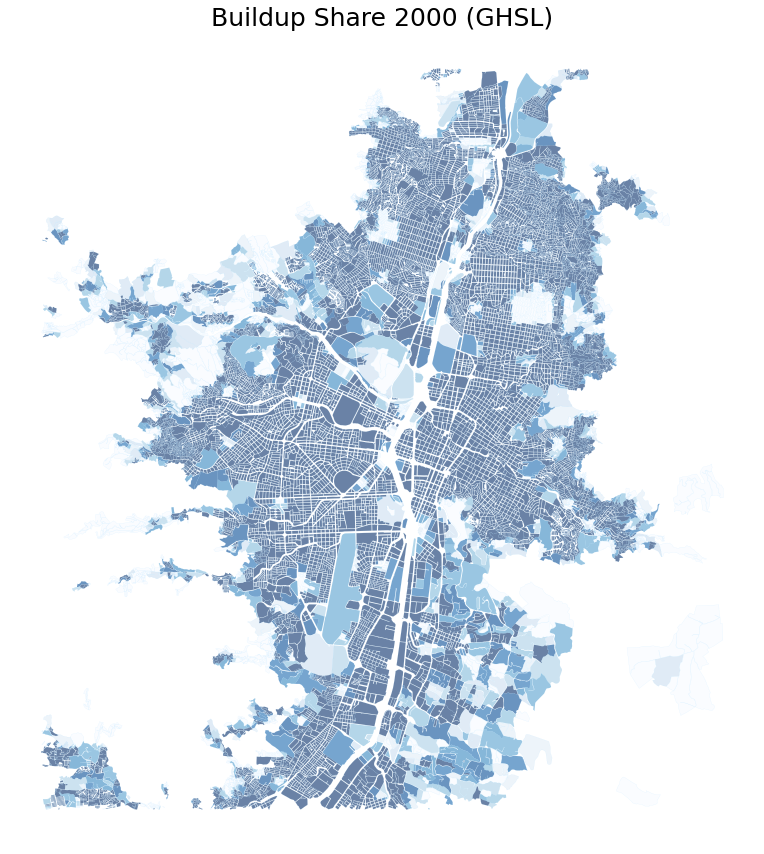

In [359]:
figs = 15
plt = gdf_bu_from_agg.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#8cd3ff', #'#0e6b52',
                             linewidth=.1,
                             column='mean',
                             scheme='NaturalBreaks',#'QUANTILES',
                             k=10,
                             #hatch='/',
                             cmap='Blues', 
                             #legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Buildup Share 1990 (GHSL)", fontsize=25)
plt.axis('off')

In [223]:
 from google.colab import files
plt.figure.savefig('medellin_bu_1990.png')
files.download('medellin_bu_1990.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### 2015

In [224]:
TotalBuiltUp_2015 = builtUpGHSL.gte(3).rename('2015').addBands(builtUpGHSL.gte(1).rename('total'))
TotalBuiltUp_2015_area = TotalBuiltUp_2015.multiply(ee.Image.pixelArea())#.divide(1000000)

In [225]:
bu_to_agg = TotalBuiltUp_2015_area.reduceRegions(collection= AOI_level,reducer=ee.Reducer.sum(),scale= AOI_pixel)
#bu_to_agg = bu_to.rename('bu').reduceRegions(collection= parcels,reducer=ee.Reducer.mean(), scale= 200)

In [226]:
geemap.ee_to_shp(bu_to_agg, 'bu_to_agg.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
An error occurred while downloading. 
 Retrying ...
Generating URL ...
Please wait ...
Data downloaded to /content/bu_to_agg.shp


In [227]:
df_bu_to_agg = gpd.read_file('bu_to_agg.shp')

pip_mask = df_bu_to_agg.within(medellin_aoi)
gdf_bu_to_agg = df_bu_to_agg.loc[pip_mask].copy()
print(df_bu_to_agg.shape,gdf_bu_to_agg.shape)

(16387, 13) (16218, 13)


In [228]:
gdf_bu_to_agg['mean'] = gdf_bu_to_agg['2015'] / (gdf_bu_to_agg['total'] +1)

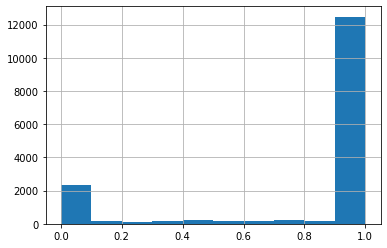

In [229]:
gdf_bu_to_agg['mean'].hist()

(-75.66011035656898, -75.5033217358933, 6.166306199889512, 6.335666505588572)

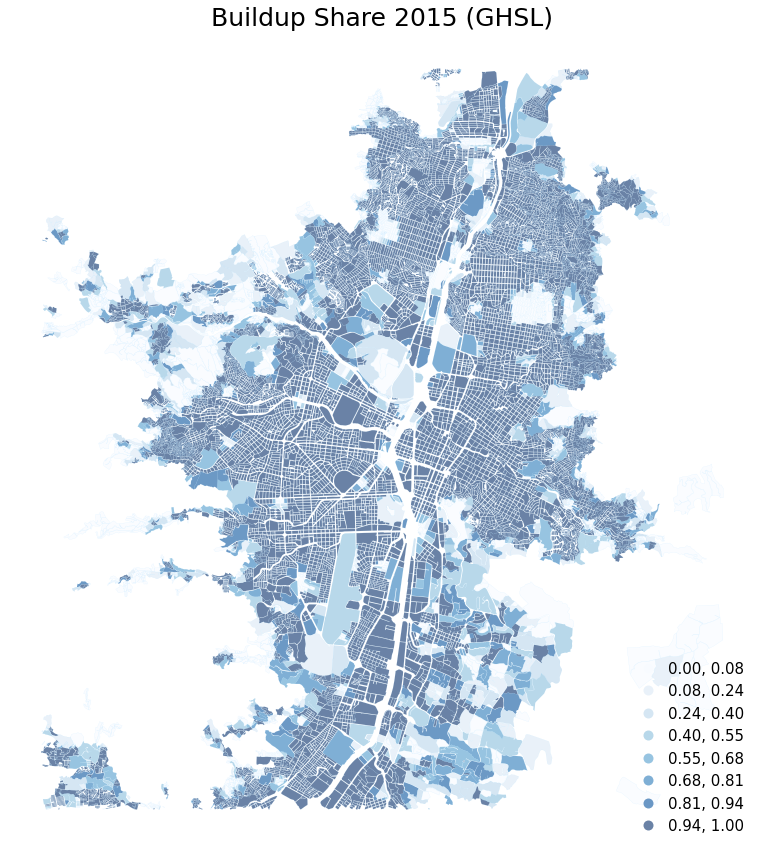

In [232]:
figs = 15
plt = gdf_bu_to_agg.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#8cd3ff', #'#0e6b52',
                             linewidth=.1,
                             column='mean',
                             scheme='NaturalBreaks',#'QUANTILES',
                             k=8,
                             #hatch='/',
                             cmap='Blues', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Buildup Share 2015 (GHSL)", fontsize=25)
plt.axis('off')

In [233]:
from google.colab import files
plt.figure.savefig('medellin_bu_2015.png')
files.download('medellin_bu_2015.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Change

In [360]:
gdf_bu_to_agg[:2]

,SHAPE_LEN,COD_DPTO,total,COD_AG,COD_MPIO,COD_DANE,2015,COD_RDTM,COD_CPOB,SHAPE_AREA,COD_CLASE,COD_SECC,geometry,mean
0,0.003371,05,2660.432169,000001,05001,0500110000000001010101,2660.432169,050011010000000001010101,05001000,2.313257e-07,1,05001100000000010101,"POLYGON ((-75.54288 6.30169, -75.54285 6.30171...",0.999624
1,0.002620,05,1773.635907,000002,05001,0500110000000001010104,1773.635907,050011010000000001010104,05001000,1.629524e-07,1,05001100000000010101,"POLYGON ((-75.54262 6.29964, -75.54260 6.29965...",0.999437


In [361]:
#df_bu_from_agg['bu_2018'] = df_bu_from_agg['mean']
#df_bu_to_agg['bu_2021'] = df_bu_to_agg['mean']

df_bu_from_agg = gdf_bu_from_agg.rename(columns={'mean':'bu_1990'})
df_bu_to_agg = gdf_bu_to_agg.rename(columns={'mean':'bu_2015'})

df_bu_merge_agg = df_bu_to_agg[['COD_DANE','bu_2015','2015']].merge(df_bu_from_agg, on='COD_DANE')

#df_bu_merge_agg = gpd.sjoin(df_bu_to_agg[['COD_DANE','bu_2021']], df_bu_from_agg, how="inner", op='overlaps')

df_bu_merge_agg['diff_abs'] = (df_bu_merge_agg['bu_2015']  - df_bu_merge_agg['bu_1990'])
df_bu_merge_agg['diff'] = (df_bu_merge_agg['bu_2015']  - df_bu_merge_agg['bu_1990']) / (df_bu_merge_agg['bu_1990']+0.01)
df_bu_merge_agg['diff'] = df_bu_merge_agg['diff'].apply(lambda x: min(x,1))
df_bu_merge_agg[:2]

,COD_DANE,bu_2015,2015,SHAPE_LEN,COD_DPTO,total,COD_AG,COD_MPIO,COD_RDTM,1990,COD_CPOB,SHAPE_AREA,COD_CLASE,COD_SECC,geometry,bu_1990,diff_abs,diff
0,0500110000000001010101,0.999624,2660.432169,0.003371,05,2660.432169,000001,05001,050011010000000001010101,2660.432169,05001000,2.313257e-07,1,05001100000000010101,"POLYGON ((-75.54288 6.30169, -75.54285 6.30171...",0.999624,0.0,0.0
1,0500110000000001010104,0.999437,1773.635907,0.002620,05,1773.635907,000002,05001,050011010000000001010104,1773.635907,05001000,1.629524e-07,1,05001100000000010101,"POLYGON ((-75.54262 6.29964, -75.54260 6.29965...",0.999437,0.0,0.0


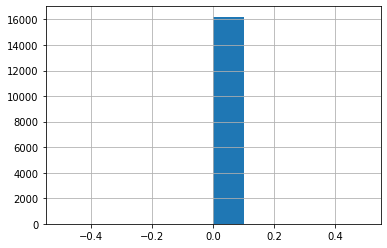

In [362]:
df_bu_merge_agg['diff'].hist()

In [363]:
import geopandas
gdf_bu_merge_agg = geopandas.GeoDataFrame(
    df_bu_merge_agg, geometry=df_bu_merge_agg.geometry)

gdf_bu_merge_agg = gdf_bu_merge_agg.set_crs(epsg=3857, inplace=True)

In [364]:
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
viridis = cm.get_cmap('Blues', 256)
newcolors = viridis(np.linspace(0, 1, 256))
pink = np.array([220/256, 20/256, 60/256, 1]) # 	220,20,60
newcolors[:25, :] = pink
newblues = ListedColormap(newcolors)

/usr/local/lib/python3.7/dist-packages/mapclassify/classifiers.py:1714: UserWarning: Warning: Not enough unique values in array to form k classes
  Warn(ms, UserWarning)
/usr/local/lib/python3.7/dist-packages/mapclassify/classifiers.py:1715: UserWarning: Warning: setting k to 1
  Warn("Warning: setting k to %d" % uvk, UserWarning)
/usr/local/lib/python3.7/dist-packages/mapclassify/classifiers.py:887: RuntimeWarning: invalid value encountered in double_scalars
  gadf = 1 - self.adcm / adam


(-75.66011035656898, -75.5033217358933, 6.166306199889512, 6.335666505588572)

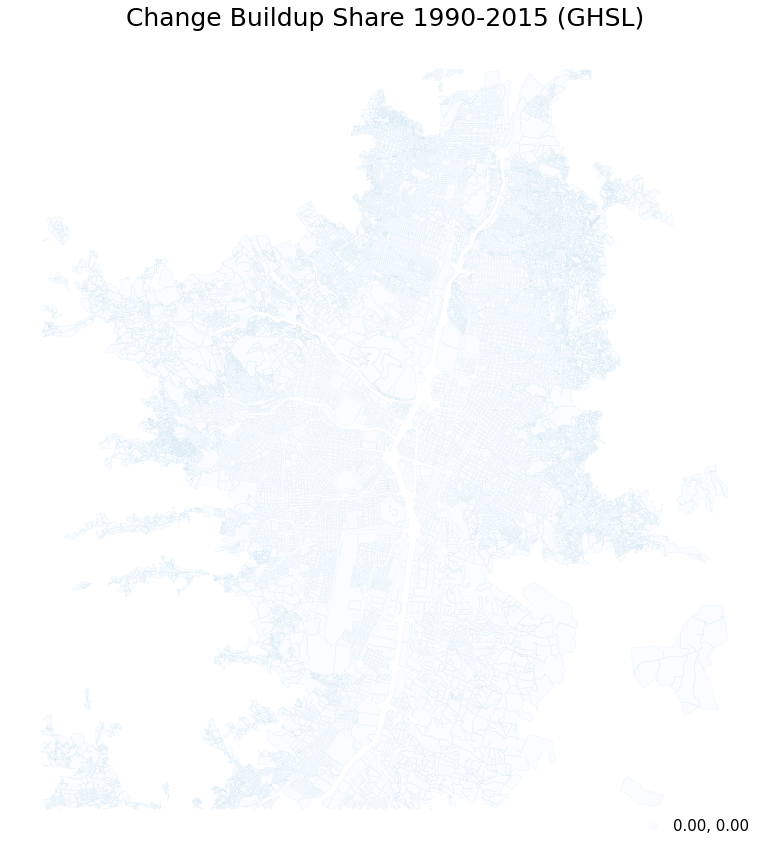

In [366]:
figs = 15
plt = gdf_bu_merge_agg.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#6ab1dd', #'#0e6b52',
                             linewidth=.1,
                             column='diff_abs',
                             scheme='NaturalBreaks',#'QUANTILES',
                             k=8,
                             #hatch='/',
                             cmap='Blues', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Change Buildup Share 1990-2015 (GHSL)", fontsize=25)
plt.axis('off')

In [248]:
from google.colab import files
plt.figure.savefig('medellin_bu_1990_2015.png')
files.download('medellin_bu_1990_2015.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

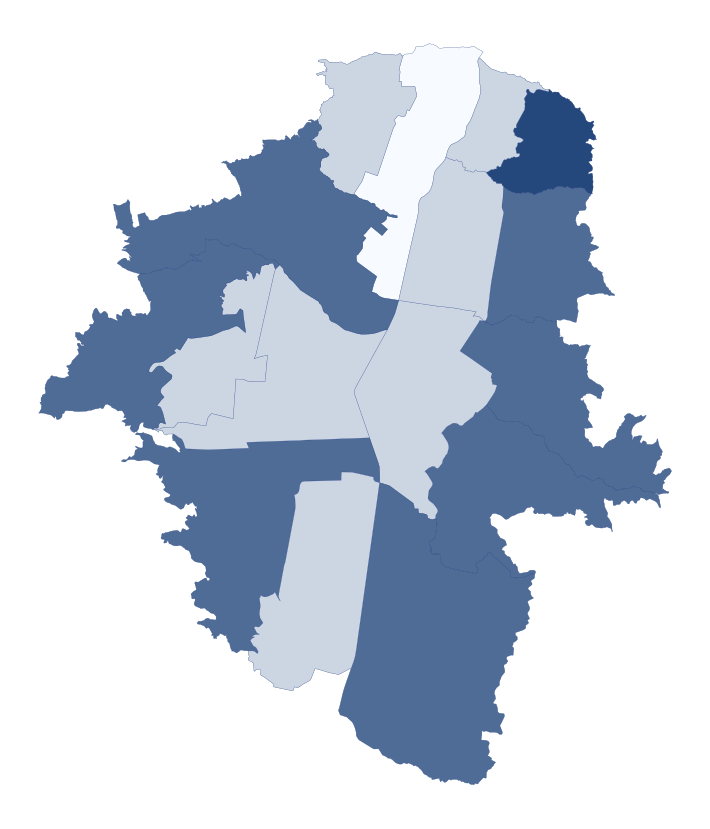

In [ ]:
import matplotlib.pyplot as plt
figs = 15
fig, ax = plt.subplots(figsize=(figs, figs))

ax.set_aspect('equal')

gdf_bu_from_agg.plot(ax=ax, alpha=0.6, edgecolor='#415996', linewidth=.3,column='mean', scheme='QUANTILES', k=2, cmap='Blues')
gdf_bu_merge_agg.plot(ax=ax, alpha=0.7, edgecolor='#415996', linewidth=.3,column='diff', scheme='QUANTILES', k=2, cmap='Blues')#, legend=True)
plt.axis('off')

plt.show();

### 2018

In [ ]:
# Built-up area from the Global Human Settlement Layer opf the JRC
builtUpGHSL = ee.Image("JRC/GHSL/P2016/BUILT_LDSMT_GLOBE_V1").select('built').clip(adminArea)
# select the Multitemporal built-up presence layer

# get the area that was built-up in 2000 from the "Multitemporal built-up presence" layer = past period                
TotalBuiltUp_2015 = builtUpGHSL.gt(3).updateMask(builtUpGHSL.gt(3)).gt(.5)
TotalBuiltUp_2000 = builtUpGHSL.gt(4).updateMask(builtUpGHSL.gt(4)).gt(.5)
TotalBuiltUp_1990 = builtUpGHSL.gt(5).updateMask(builtUpGHSL.gt(5)).gt(.5)


In [ ]:
builtUpPoP_2015 = ee.Image("users/eriklehmann91/col_bsgme_v0a_100m_2015")
#builtUpPoP_2015 = builtUpPoP_2015.updateMask(builtUpPoP_2015.gt(0))
builtUpPoP_2020 = ee.Image("users/eriklehmann91/col_bsgme_v0a_100m_2020")
builtUpPoP_2018 = ee.ImageCollection("users/ghsl/S2_CNN").mosaic().clip(adminArea).gt(20)
builtUpPoP_2021 = ee.Image("users/eriklehmann91/medellin_buildup_2021").clip(adminArea).gt(.5)

In [ ]:
###
bu_from = builtUpPoP_2018
bu_to = builtUpPoP_2021

In [ ]:
bu_from_agg = bu_from.rename('bu').reduceRegions(collection= parcels,reducer=ee.Reducer.mean(), scale= 200)
bu_to_agg = bu_to.rename('bu').reduceRegions(collection= parcels,reducer=ee.Reducer.mean(), scale= 200)

In [ ]:
geemap.ee_to_shp(bu_from_agg, 'bu_from_agg.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
Data downloaded to /content/bu_from_agg.shp


In [ ]:
df_bu_from_agg = gpd.read_file('bu_from_agg.shp')

pip_mask = df_bu_from_agg.within(medellin_aoi)
gdf_bu_from_agg = df_bu_from_agg.loc[pip_mask].copy()
print(df_bu_from_agg.shape,gdf_bu_from_agg.shape)

(16, 6) (16, 6)


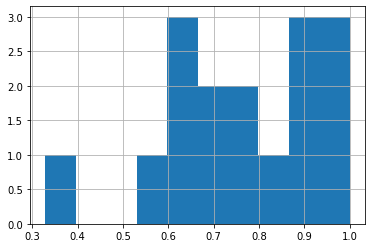

In [ ]:
df_bu_from_agg['mean'].hist()

In [ ]:
#df_bu_from_agg['bu_2018'] = df_bu_from_agg['mean'].apply(lambda x: (x>20)*1) 
#df_bu_from_agg['bu_2018'].hist()

(-75.6447057091541, -75.51564504764828, 6.168440119079672, 6.319695974571951)

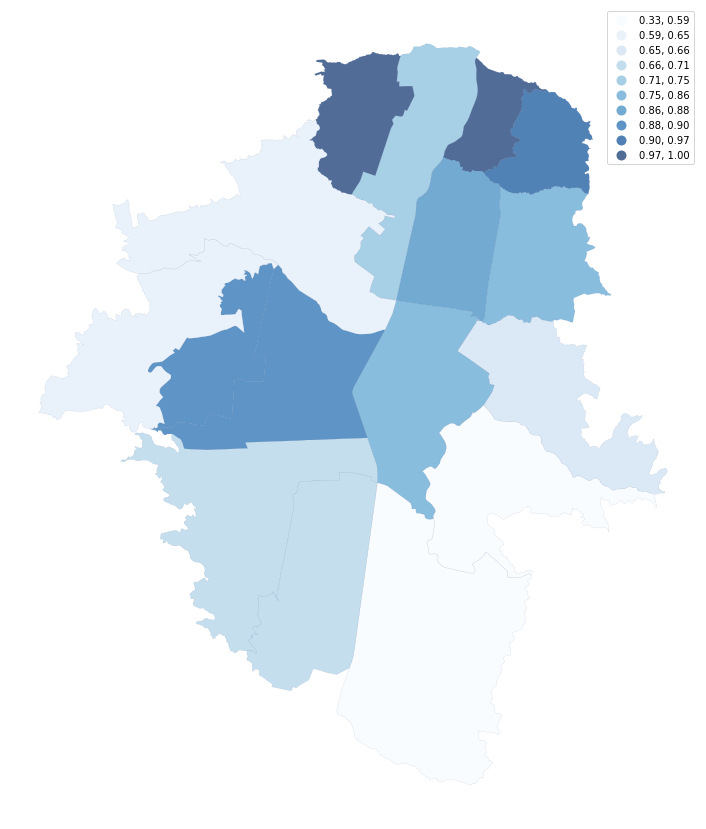

In [ ]:
figs = 15
plt = df_bu_from_agg.plot(figsize=(figs, figs), alpha=0.7, edgecolor='#415996', linewidth=.1,column='mean', scheme='QUANTILES', k=10, cmap='Blues', legend=True)
plt.set_label('build up percentage')
#plt.legend(loc="upper right")
plt.axis('off')

In [ ]:
from google.colab import files
plt.figure.savefig('medellin_bu_2018.png')
files.download('medellin_bu_2018.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Now

In [ ]:
geemap.ee_to_shp(bu_to_agg, 'bu_to_agg.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
Data downloaded to /content/bu_to_agg.shp


In [ ]:
df_bu_to_agg = gpd.read_file('bu_to_agg.shp')

pip_mask = df_bu_to_agg.within(medellin_aoi)
gdf_bu_to_agg = df_bu_to_agg.loc[pip_mask].copy()
print(df_bu_to_agg.shape,gdf_bu_to_agg.shape)

(16, 6) (16, 6)


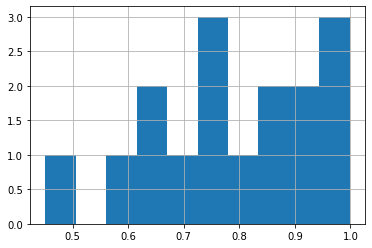

In [ ]:
gdf_bu_to_agg['mean'].hist()

In [ ]:
#df_bu_from_agg['bu_2021'] = df_bu_from_agg['mean'].apply(lambda x: (x>.5)*1) 

(-75.6447057091541, -75.51564504764828, 6.168440119079672, 6.319695974571951)

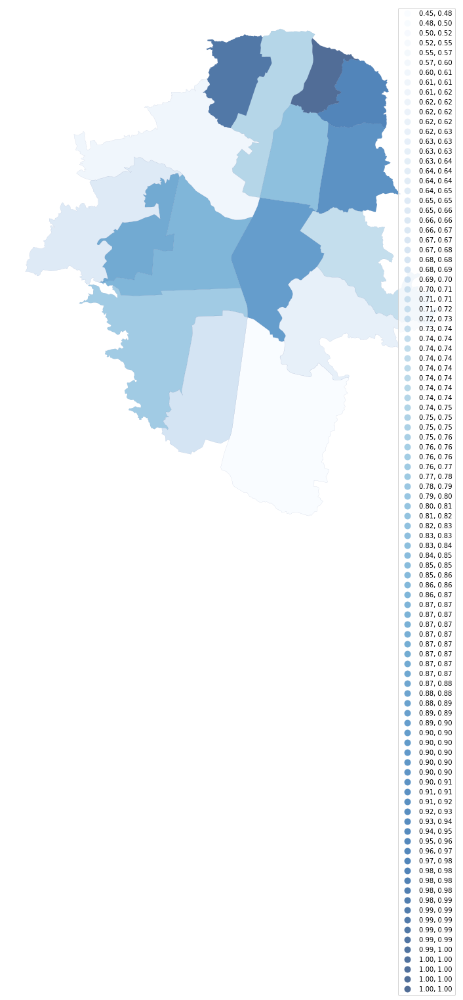

In [ ]:
figs = 15
plt = df_bu_to_agg.plot(figsize=(figs, figs), alpha=0.7, edgecolor='#415996', linewidth=.1,column='mean', scheme='QUANTILES', k=10, cmap='Blues', legend=True)
plt.set_label('build up percentage')
#plt.legend(loc="upper right")
plt.axis('off')

In [ ]:
from google.colab import files
plt.figure.savefig('medellin_bu_2021.png')
files.download('medellin_bu_2021.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Change

In [506]:
#df_bu_from_agg['bu_2018'] = df_bu_from_agg['mean']
#df_bu_to_agg['bu_2021'] = df_bu_to_agg['mean']

df_bu_from_agg = df_bu_from_agg.rename(columns={'mean':'bu_2018'})
df_bu_to_agg = df_bu_to_agg.rename(columns={'mean':'bu_2021'})

df_bu_merge_agg = df_bu_to_agg[['COD_DANE','bu_2021']].merge(df_bu_from_agg, on='COD_DANE')

#df_bu_merge_agg = gpd.sjoin(df_bu_to_agg[['COD_DANE','bu_2021']], df_bu_from_agg, how="inner", op='overlaps')

df_bu_merge_agg['diff'] = df_bu_merge_agg['bu_2021']  - (df_bu_merge_agg['bu_2018'] /100)
df_bu_merge_agg[:2]

KeyError: ignored

In [507]:
import geopandas
gdf_bu_merge_agg = geopandas.GeoDataFrame(
    df_bu_merge_agg, geometry=df_bu_merge_agg.geometry)

gdf_bu_merge_agg = gdf_bu_merge_agg.set_crs(epsg=3857, inplace=True)

KeyError: ignored

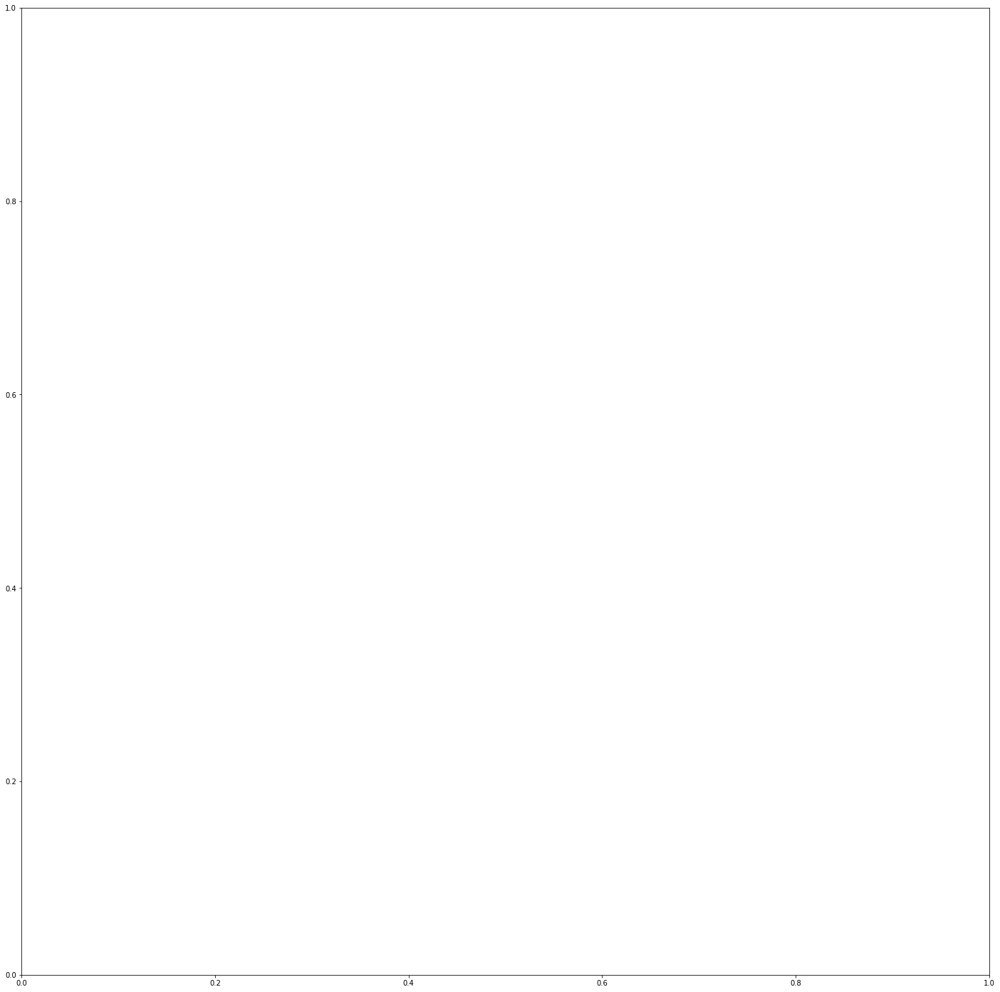

In [508]:
figs = 25
plt = gdf_bu_merge_agg.plot(figsize=(figs, figs), alpha=0.7, edgecolor='#415996', linewidth=.1,column='diff', scheme='QUANTILES', k=100, cmap='Blues', legend=True)
plt.set_label('build up percentage')
#plt.legend(loc="upper right")
plt.axis('off')

In [ ]:
from google.colab import files
plt.figure.savefig('medellin_bu_2018_2021.png')
files.download('medellin_bu_2018_2021.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/dist-packages/mapclassify/classifiers.py:235: UserWarning: Warning: Not enough unique values in array to form k classes
  "Warning: Not enough unique values in array to form k classes", UserWarning
/usr/local/lib/python3.7/dist-packages/mapclassify/classifiers.py:237: UserWarning: Warning: setting k to 22
  Warn("Warning: setting k to %d" % k_q, UserWarning)


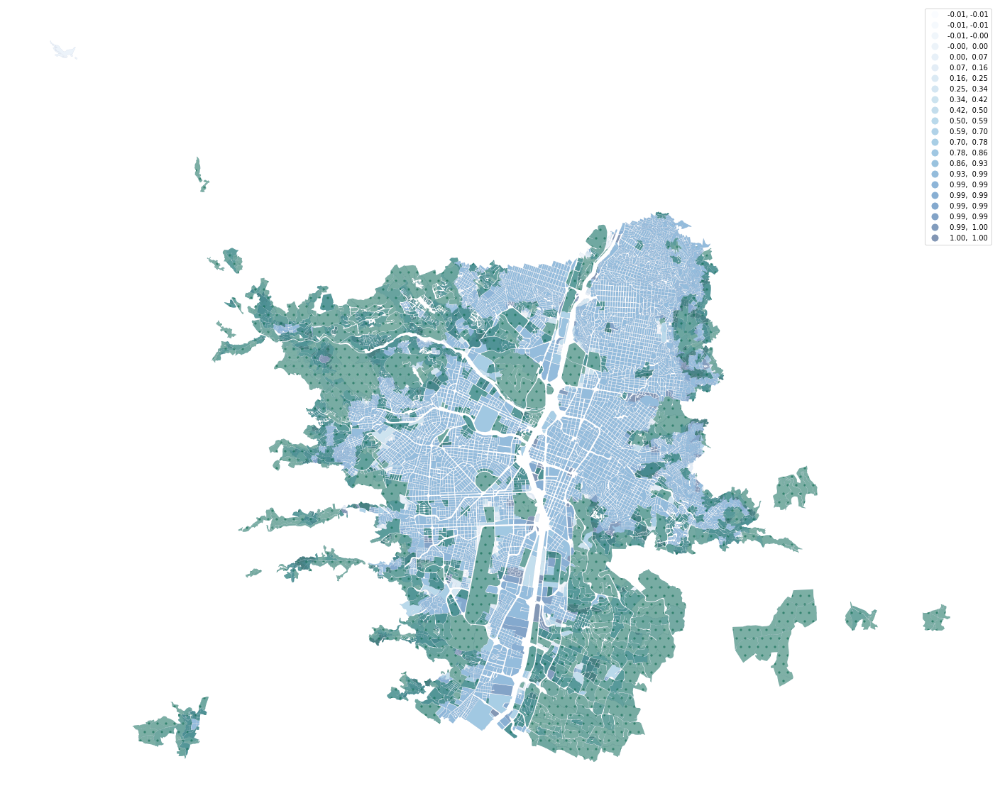

In [ ]:
import matplotlib.pyplot as plt
figs = 25
fig, ax = plt.subplots(figsize=(figs, figs))

ax.set_aspect('equal')

gdf_bu_merge_agg.plot(ax=ax, alpha=0.5, edgecolor='#415996', linewidth=.1,column='diff', scheme='QUANTILES', k=100, cmap='Blues', legend=True)
plt.axis('off')
gdf_aoi[gdf_aoi['ndvi']==True].plot(ax=ax,hatch= ".", alpha=.5, edgecolor='#0e6b52', linewidth=.09, color='#0e6b52')


plt.show();

In [ ]:
from google.colab import files
fig.savefig('medellin_bu_change_green.png')
files.download('medellin_bu_change_green.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## World Pop

### Then

In [304]:
wpop_2020 = ee.ImageCollection("WorldPop/GP/100m/pop")\
                        .filter(ee.Filter.eq("year",2020))\
                        .filter(ee.Filter.eq("country",'COL'))\
                        .toBands()\
                        .clip(adminArea)

wpop_2015 = ee.ImageCollection("WorldPop/GP/100m/pop")\
                        .filter(ee.Filter.eq("year",2015))\
                        .filter(ee.Filter.eq("country",'COL'))\
                        .toBands()\
                        .clip(adminArea)
                  

In [257]:
pop_1990 = ee.Image(ee.ImageCollection('JRC/GHSL/P2016/POP_GPW_GLOBE_V1')\
                  .filter(ee.Filter.date('1990-01-01', '1990-12-31'))\
                  .select('population_count')\
                  .reduce(ee.Reducer.mean()))#.clip(med)

pop_2000 = ee.Image(ee.ImageCollection('JRC/GHSL/P2016/POP_GPW_GLOBE_V1')\
                  .filter(ee.Filter.date('2000-01-01', '2000-12-31'))\
                  .select('population_count')\
                  .reduce(ee.Reducer.mean()))#.clip(med)

pop_2015 = ee.Image(ee.ImageCollection('JRC/GHSL/P2016/POP_GPW_GLOBE_V1')\
                  .filter(ee.Filter.date('2015-01-01', '2015-12-31'))\
                  .select('population_count')\
                  .reduce(ee.Reducer.mean()))#.clip(med)

  

### Neigborhoods

In [ ]:
wpop_1990_urb = pop_1990.rename('pop').reduceRegions(collection= AOI_level,reducer=ee.Reducer.sum(), scale= AOI_pixel)
geemap.ee_to_shp(wpop_1990_urb, 'abundance_perc.shp', selectors=None, verbose=True, keep_zip=False) 

In [307]:
df_wpop_1990 = gpd.read_file('abundance_perc.shp')
df_wpop_1990[:2]


,area,city,name,admin_leve,sum,geometry
0,32.441630,Medell?n,Comuna 12 - La Am?rica,8,77231.847576,"POLYGON ((-75.61843 6.25217, -75.61821 6.25274..."
1,49.518716,Medell?n,Comuna 5 - Castilla,8,105585.567064,"POLYGON ((-75.58037 6.28478, -75.58034 6.28495..."


In [308]:
df_wpop_1990['sum'].sum()

1632649.548101646

In [311]:
df_wpop_1990['pop_share'] = df_wpop_1990['sum'] /df_wpop_1990['sum'].sum() *100
df_wpop_1990['area_share'] = df_wpop_1990['area'] /df_wpop_1990['area'].sum() *100
df_wpop_1990['share_share'] = df_wpop_1990['pop_share'] / df_wpop_1990['area_share']

In [312]:
df_wpop_1990.sort_values('share_share')

,area,city,name,admin_leve,sum,geometry,pop_share,area_share,share_share
9,120.715300,Medell?n,Comuna 14 - El Poblado,8,162180.927604,"POLYGON ((-75.58326 6.18910, -75.58308 6.18958...",9.933603,13.734466,0.723261
7,58.729090,Medell?n,Comuna 9 - Buenos Aires,8,79923.752070,"POLYGON ((-75.56724 6.23345, -75.56649 6.23406...",4.895340,6.681943,0.732622
15,84.297027,Medell?n,Comuna 7 - Robledo,8,122028.537263,"POLYGON ((-75.62504 6.28295, -75.62481 6.28302...",7.474264,9.590952,0.779304
6,59.999685,Medell?n,Comuna 13 - San Javier,8,93571.761791,"POLYGON ((-75.63884 6.24424, -75.63879 6.24439...",5.731283,6.826505,0.839563
10,79.405732,Medell?n,Comuna 16 - Bel?n,8,145687.888487,"POLYGON ((-75.62353 6.23537, -75.62325 6.23558...",8.923402,9.034442,0.987709
5,54.669807,Medell?n,Comuna 8 - Villa Hermosa,8,100794.240803,"POLYGON ((-75.56071 6.25577, -75.56012 6.25667...",6.173661,6.220095,0.992535
2,41.726069,Medell?n,Comuna 3 - Manrique,8,78983.160561,"POLYGON ((-75.55625 6.26134, -75.55615 6.26135...",4.837729,4.747412,1.019024
11,62.417035,Medell?n,Comuna 15 - Guayabal,8,125371.995137,"POLYGON ((-75.60002 6.19854, -75.59991 6.19893...",7.679051,7.101541,1.081322
13,31.456390,Medell?n,Comuna 6 - Doce de Octubre,8,64217.623733,"POLYGON ((-75.58836 6.29501, -75.58829 6.29494...",3.933338,3.578972,1.099013
1,49.518716,Medell?n,Comuna 5 - Castilla,8,105585.567064,"POLYGON ((-75.58037 6.28478, -75.58034 6.28495...",6.467130,5.634026,1.147870


In [317]:
pop_2015_urb = pop_2015.rename('pop').reduceRegions(collection= neighborhoods,reducer=ee.Reducer.sum(), scale= AOI_pixel)
geemap.ee_to_shp(pop_2015_urb, 'abundance_perc.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
Data downloaded to /content/abundance_perc.shp


In [318]:
df_pop_2015 = gpd.read_file('abundance_perc.shp')
df_pop_2015['pop_share'] = df_pop_2015['sum'] /df_pop_2015['sum'].sum() *100
df_pop_2015['area_share'] = df_pop_2015['area'] /df_pop_2015['area'].sum() *100
df_pop_2015['share_share'] = df_pop_2015['pop_share'] / df_pop_2015['area_share']

In [319]:
df_pop_2015['sum'].sum()

2147134.657389556

In [320]:
df_pop_2015.sort_values('share_share')

,area,city,name,admin_leve,sum,geometry,pop_share,area_share,share_share
7,58.729090,Medell?n,Comuna 9 - Buenos Aires,8,115262.867036,"POLYGON ((-75.56724 6.23345, -75.56649 6.23406...",5.368218,6.681943,0.803392
15,84.297027,Medell?n,Comuna 7 - Robledo,8,170068.989068,"POLYGON ((-75.62504 6.28295, -75.62481 6.28302...",7.920742,9.590952,0.825856
9,120.715300,Medell?n,Comuna 14 - El Poblado,8,248318.744389,"POLYGON ((-75.58326 6.18910, -75.58308 6.18958...",11.565122,13.734466,0.842051
6,59.999685,Medell?n,Comuna 13 - San Javier,8,132632.546029,"POLYGON ((-75.63884 6.24424, -75.63879 6.24439...",6.177188,6.826505,0.904883
5,54.669807,Medell?n,Comuna 8 - Villa Hermosa,8,120934.980697,"POLYGON ((-75.56071 6.25577, -75.56012 6.25667...",5.632389,6.220095,0.905515
2,41.726069,Medell?n,Comuna 3 - Manrique,8,101387.335508,"POLYGON ((-75.55625 6.26134, -75.55615 6.26135...",4.721983,4.747412,0.994644
10,79.405732,Medell?n,Comuna 16 - Bel?n,8,201908.859151,"POLYGON ((-75.62353 6.23537, -75.62325 6.23558...",9.403642,9.034442,1.040866
11,62.417035,Medell?n,Comuna 15 - Guayabal,8,159182.141603,"POLYGON ((-75.60002 6.19854, -75.59991 6.19893...",7.413701,7.101541,1.043957
1,49.518716,Medell?n,Comuna 5 - Castilla,8,127790.084689,"POLYGON ((-75.58037 6.28478, -75.58034 6.28495...",5.951657,5.634026,1.056377
13,31.456390,Medell?n,Comuna 6 - Doce de Octubre,8,84691.537656,"POLYGON ((-75.58836 6.29501, -75.58829 6.29494...",3.944398,3.578972,1.102104


In [321]:
df_wpop_1990 = df_wpop_1990.rename(columns={'sum':'pop_1990'})
df_pop_2015 = df_pop_2015.rename(columns={'sum':'pop_2015'})

df_pop__agg = df_pop_2015[['name','pop_2015']].merge(df_wpop_1990, on='name')
df_pop__agg['change'] = (df_pop__agg['pop_2015'] - df_pop__agg['pop_1990'])/df_pop__agg['pop_1990']
df_pop__agg.sort_values('change')

,name,pop_2015,area,city,admin_leve,pop_1990,geometry,pop_share,area_share,share_share,change
5,Comuna 8 - Villa Hermosa,120934.980697,54.669807,Medell?n,8,100794.240803,"POLYGON ((-75.56071 6.25577, -75.56012 6.25667...",6.173661,6.220095,0.992535,0.199820
1,Comuna 5 - Castilla,127790.084689,49.518716,Medell?n,8,105585.567064,"POLYGON ((-75.58037 6.28478, -75.58034 6.28495...",6.467130,5.634026,1.147870,0.210299
14,Comuna 11 - Laureles-Estadio,173050.874008,60.414607,Medell?n,8,141382.475614,"POLYGON ((-75.61750 6.24118, -75.61746 6.24119...",8.659695,6.873714,1.259828,0.223991
8,Comuna 10 - La Candelaria,171275.403440,60.113488,Medell?n,8,139592.514385,"POLYGON ((-75.58029 6.24819, -75.58022 6.24866...",8.550060,6.839454,1.250109,0.226967
3,Comuna 1 - Popular,73445.324245,25.196548,Medell?n,8,59487.633741,"POLYGON ((-75.55580 6.28894, -75.55549 6.28902...",3.643625,2.866755,1.270993,0.234632
12,Comuna 4 - Aranjuez,113798.426847,39.897864,Medell?n,8,91520.912720,"POLYGON ((-75.57209 6.26517, -75.57082 6.27083...",5.605668,4.539407,1.234890,0.243414
4,Comuna 2 - Santa Cruz,56461.308933,17.923397,Medell?n,8,45088.709552,"POLYGON ((-75.56335 6.29172, -75.56328 6.29189...",2.761689,2.039247,1.354269,0.252227
0,Comuna 12 - La Am?rica,96925.234090,32.441630,Medell?n,8,77231.847576,"POLYGON ((-75.61843 6.25217, -75.61821 6.25274...",4.730461,3.691069,1.281596,0.254990
11,Comuna 15 - Guayabal,159182.141603,62.417035,Medell?n,8,125371.995137,"POLYGON ((-75.60002 6.19854, -75.59991 6.19893...",7.679051,7.101541,1.081322,0.269679
2,Comuna 3 - Manrique,101387.335508,41.726069,Medell?n,8,78983.160561,"POLYGON ((-75.55625 6.26134, -75.55615 6.26135...",4.837729,4.747412,1.019024,0.283658


In [255]:

no = ['0: -100%','1: -75%','2: -50%','3: -25%','4: 0%','5: 25%','6: 50%','7: 75%','8: 100%']
color_pal_2 = ['e55b5b','ea7b7b','f2adad','f7cdcd','ffffff','ffe39f','ffd56f','ffc73e','ffb90f']

ld2 = dict(zip(no,color_pal_2))
populationCountVis2 = {
  'min': 1,
  'max': 2000,
  'palette': color_pal_2,
};

In [258]:
# plot zones
Map = geemap.Map(center=[y,x], zoom=13)
# Set some visualization parameters
Map.add_basemap('ESRI')
Map.addLayer(pop_1990.mask(pop_1990.gt(0)), populationCountVis2,'pop', True);
Map.addLayer(pop_2000.mask(pop_2000.gt(0)), populationCountVis2,'pop00', True);
Map.addLayer(pop_2015.mask(pop_2015.gt(0)), populationCountVis2,'pop15', True);
#Map.addLayer(TotalBuiltUp_1990, {min: 0, max: 1, 'palette':['ffffff','334682']},'BU90', True);
#Map.addLayer(TotalBuiltUp_2000, {min: 0, max: 1, 'palette':['ffffff','334682']},'BU00', True);
#Map.addLayer(TotalBuiltUp_2015, {min: 0, max: 1, 'palette':['ffffff','AA4682']},'BU15', True);
#Map.addLayer(areaOtherRoads,roadsViz, 'OtherRoads', True);

Map

In [ ]:
abundance_perc = pop_1990.reduceRegion(ee.Reducer.sum(), adminArea, 200)
print(abundance_perc.getInfo())
abundance_perc = pop_2000.reduceRegion(ee.Reducer.sum(), adminArea, 200)
print(abundance_perc.getInfo())
abundance_perc = pop_2015.reduceRegion(ee.Reducer.sum(), adminArea, 200)
print(abundance_perc.getInfo())

{'population_count_mean': 2549336.1557664066}
{'population_count_mean': 3033114.965723912}
{'population_count_mean': 3510392.6366670406}


### 1990


In [251]:
wpop_1990_urb = pop_1990.rename('pop').reduceRegions(collection= AOI_level,reducer=ee.Reducer.mean(), scale= AOI_pixel)
geemap.ee_to_shp(wpop_1990_urb, 'medellin_parcels_pop_1990.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
An error occurred while downloading. 
 Retrying ...
Generating URL ...
Please wait ...
Data downloaded to /content/medellin_parcels_pop_1990.shp


In [252]:
df_wpop_1990 = gpd.read_file('medellin_parcels_pop_1990.shp')
pip_mask_1990 = df_wpop_1990.within(medellin_aoi)
gdf_aoi_pop_1990 = df_wpop_1990.loc[pip_mask_1990].copy()

print(df_wpop_1990.shape,gdf_aoi_pop_1990.shape)

(16387, 12) (16218, 12)


In [55]:
gdf_aoi_pop_1990['centroid'] = gdf_aoi_pop_1990['geometry'].centroid

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  """Entry point for launching an IPython kernel.


In [56]:
gdf_aoi_pop_1990['coords'] = gdf_aoi_pop_1990['geometry'].apply(lambda x: x.representative_point().coords[:])
gdf_aoi_pop_1990['coords'] = [coords[0] for coords in gdf_aoi_pop_1990['coords']]

In [57]:
gdf_aoi_pop_1990[:2]

,SHAPE_LEN,COD_DPTO,COD_AG,COD_MPIO,COD_DANE,mean,COD_RDTM,COD_CPOB,SHAPE_AREA,COD_CLASE,COD_SECC,geometry,centroid,coords
0,0.003371,05,000001,05001,0500110000000001010101,1210.289945,050011010000000001010101,05001000,2.313257e-07,1,05001100000000010101,"POLYGON ((-75.54288 6.30169, -75.54285 6.30171...",POINT (-75.54256 6.30129),"(-75.54245060600402, 6.301206987336627)"
1,0.002620,05,000002,05001,0500110000000001010104,1295.270752,050011010000000001010104,05001000,1.629524e-07,1,05001100000000010101,"POLYGON ((-75.54262 6.29964, -75.54260 6.29965...",POINT (-75.54237 6.29938),"(-75.54237977219107, 6.299394366984484)"


In [58]:
#gdf_aoi_pop_1990['sum'] = gdf_aoi_pop_1990['sum'] /  gdf_aoi_pop_1990['area']

(-75.6447057091541, -75.51564504764828, 6.168440119079672, 6.319695974571951)

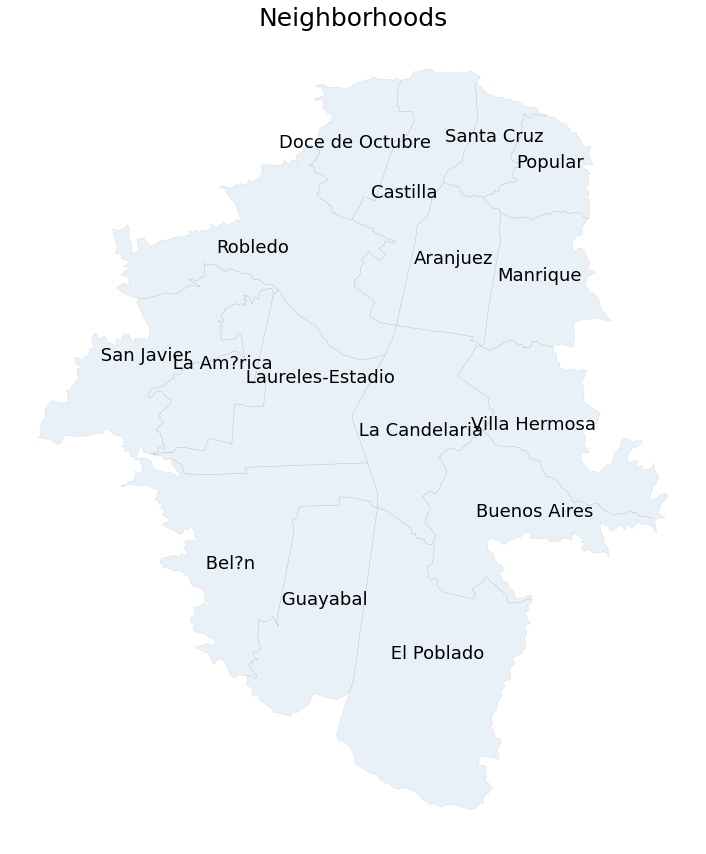

In [432]:
figs = 15
plt = gdf_aoi_pop_1990.plot(figsize=(figs, figs),
                             alpha=0.1,
                             edgecolor='#000000', #'#0e6b52',
                             linewidth=.5)
               
plt.set_title("Neighborhoods", fontsize=25)
for idx, row in gdf_aoi_pop_1990.iterrows():
    plt.annotate(s=row['name'][11:], xy=row['coords'], horizontalalignment='center', fontsize=18)
plt.axis('off')

(-75.66011035656898, -75.5033217358933, 6.166306199889512, 6.335666505588572)

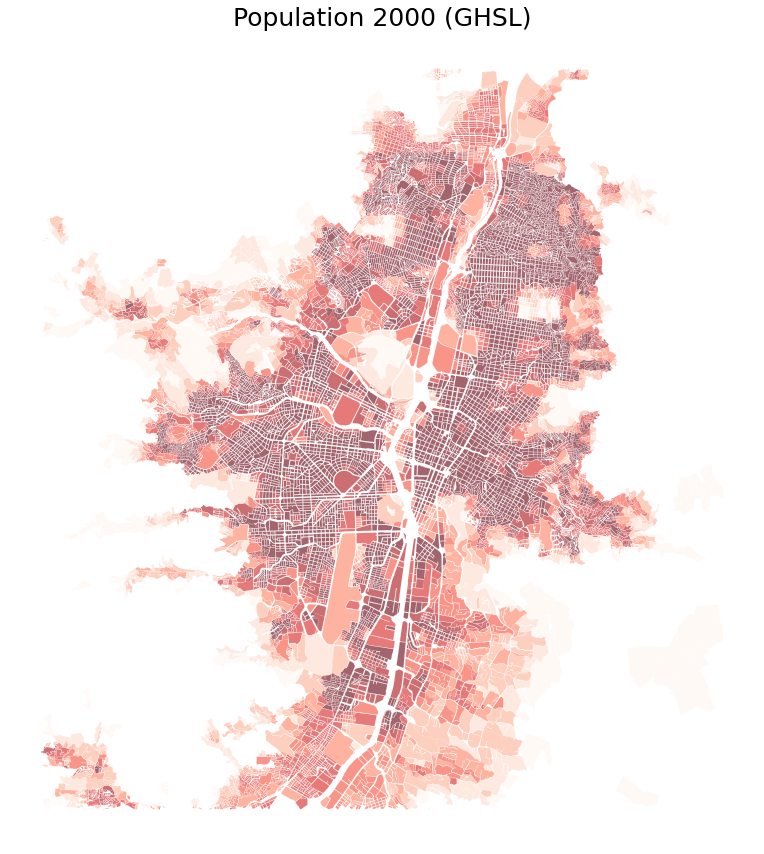

In [260]:
figs = 15
plt = gdf_aoi_pop_1990.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#ffffff', #'#0e6b52',
                             linewidth=.1,
                             column='mean',
                             scheme='NaturalBreaks',#'QUANTILES',
                             k=8,
                             #hatch='\\',
                             cmap='Reds', 
                             #legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Population 2000 (GHSL)", fontsize=25)
#for idx, row in gdf_aoi_pop_1990.iterrows():
#    plt.annotate(s=row['name'][11:], xy=row['coords'], horizontalalignment='center')
plt.axis('off')

In [261]:
from google.colab import files
plt.figure.savefig('medellin_pop_2000.png')
files.download('medellin_pop_2000.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### 2015 (GHSL)

In [262]:
wpop_2015_urb = pop_2015.rename('pop').reduceRegions(collection= AOI_level,reducer=ee.Reducer.mean(), scale= AOI_pixel)
geemap.ee_to_shp(wpop_2015_urb, 'medellin_parcels_pop_2015.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
An error occurred while downloading. 
 Retrying ...
Generating URL ...
Please wait ...
Data downloaded to /content/medellin_parcels_pop_2015.shp


In [263]:
df_wpop_2015 = gpd.read_file('medellin_parcels_pop_2015.shp')
pip_mask_2015 = df_wpop_2015.within(medellin_aoi)
gdf_aoi_pop_2015 = df_wpop_2015.loc[pip_mask_2015].copy()

print(df_wpop_2015.shape,gdf_aoi_pop_2015.shape)

(16387, 12) (16218, 12)


(-75.66011035656898, -75.5033217358933, 6.166306199889512, 6.335666505588572)

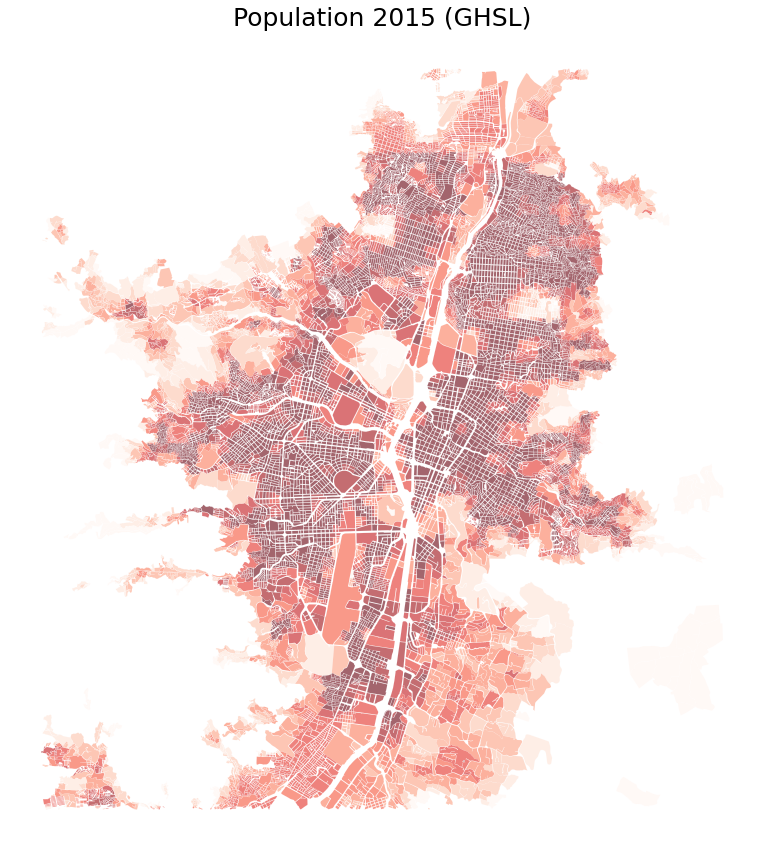

In [266]:
figs = 15
plt = gdf_aoi_pop_2015.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#ffffff', #'#0e6b52',
                             linewidth=.1,
                             column='mean',
                             scheme='NaturalBreaks',#'QUANTILES',
                             k=10,
                             #hatch='\\',
                             cmap='Reds', 
                             #legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Population 2015 (GHSL)", fontsize=25)
#for idx, row in gdf_aoi_pop_1990.iterrows():
#    plt.annotate(s=row['name'][11:], xy=row['coords'], horizontalalignment='center')
plt.axis('off')

In [267]:
from google.colab import files
plt.figure.savefig('medellin_pop_2015_ghsl.png')
files.download('medellin_pop_2015_ghsl.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Change

In [319]:
df_pop_from_agg = gdf_aoi_pop_1990.rename(columns={'mean':'pop_1990'})
df_pop_to_agg = gdf_aoi_pop_2015.rename(columns={'mean':'pop_2015'})

df_pop_merge_agg = df_pop_to_agg[['COD_DANE','pop_2015']].merge(df_pop_from_agg, on='COD_DANE') #COD_RDTM

#df_bu_merge_agg = gpd.sjoin(df_bu_to_agg[['COD_DANE','bu_2021']], df_bu_from_agg, how="inner", op='overlaps')

df_pop_merge_agg['diff'] = (df_pop_merge_agg['pop_2015']  - (df_pop_merge_agg['pop_1990'])) / (df_pop_merge_agg['pop_1990'] +1)
df_pop_merge_agg['diff_abs'] = (df_pop_merge_agg['pop_2015']  - (df_pop_merge_agg['pop_1990'])) #/ (df_pop_merge_agg['pop_2015'] +1)
df_pop_merge_agg['diff'] = df_pop_merge_agg['diff'].apply(lambda x: min(x,1))
df_pop_merge_agg[:1]

,COD_DANE,pop_2015,SHAPE_LEN,COD_DPTO,COD_AG,COD_MPIO,pop_1990,COD_RDTM,COD_CPOB,SHAPE_AREA,COD_CLASE,COD_SECC,geometry,diff,diff_abs
0,0500110000000001010101,1491.288199,0.003371,05,000001,05001,1362.229774,050011010000000001010101,05001000,2.313257e-07,1,05001100000000010101,"POLYGON ((-75.54288 6.30169, -75.54285 6.30171...",0.094671,129.058425


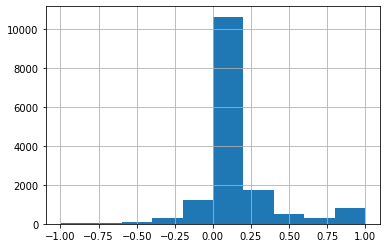

In [320]:
df_pop_merge_agg['diff'].hist()

In [321]:
import geopandas
gdf_pop_merge_agg = geopandas.GeoDataFrame(
    df_pop_merge_agg, geometry=df_pop_merge_agg.geometry)

#gdf_pop_merge_agg = gdf_pop_merge_agg.set_crs(epsg=3857, inplace=True)

In [292]:
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
viridis = cm.get_cmap('Reds', 256)
newcolors = viridis(np.linspace(0, 1, 256))
pink = np.array([179/256, 179/256, 179/256, 1]) # 	220,20,60
newcolors[:25, :] = pink
newreds = ListedColormap(newcolors)

(-75.66011035656898, -75.5033217358933, 6.166306199889512, 6.335666505588572)

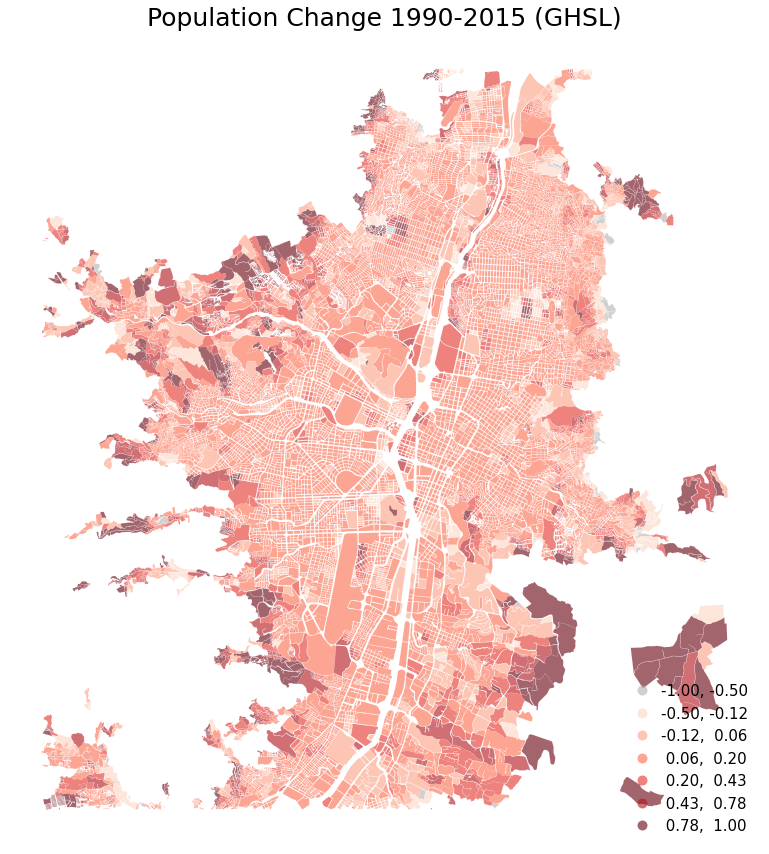

In [293]:
figs = 15
plt = gdf_pop_merge_agg.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#ffffff', #'#0e6b52',
                             linewidth=.1,
                             column='diff',
                             scheme='NaturalBreaks',#'QUANTILES',
                             k=7,
                             #hatch='\\',
                             cmap=newreds,#'Reds', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Population Change 1990-2015 (GHSL)", fontsize=25)
#for idx, row in gdf_aoi_pop_1990.iterrows():
#    plt.annotate(s=row['name'][11:], xy=row['coords'], horizontalalignment='center')
plt.axis('off')

(-75.6447057091541, -75.51564504764828, 6.168440119079672, 6.319695974571951)

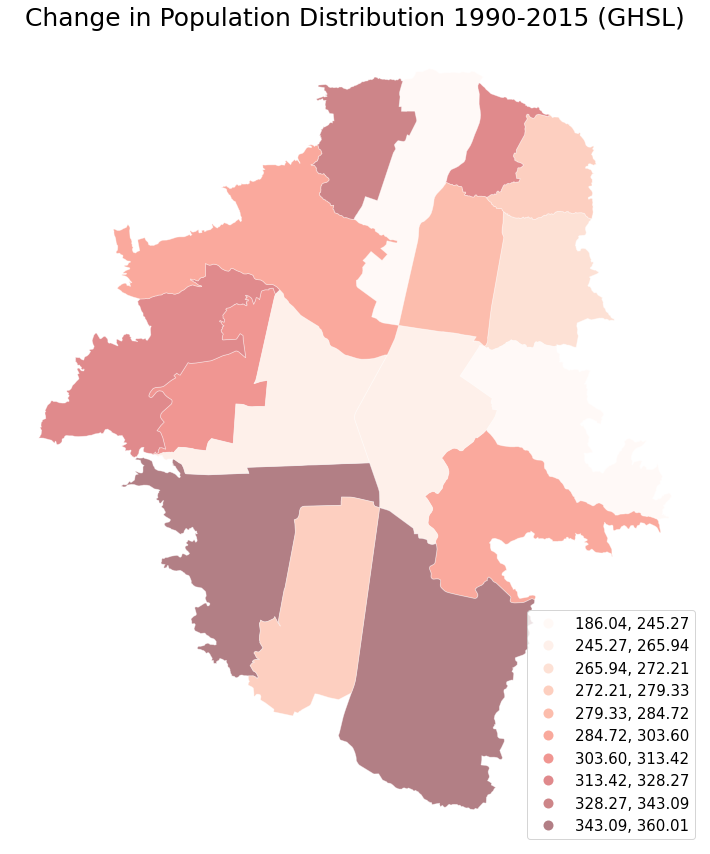

In [447]:
figs = 15
plt = gdf_pop_merge_agg.plot(figsize=(figs, figs),
                             alpha=0.5,
                             edgecolor='#ffffff',
                             linewidth=.7,
                             column='diff',
                             scheme='QUANTILES',
                             k=10,
                             cmap='Reds', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15})

plt.set_title("Change in Population Distribution 1990-2015 (GHSL)", fontsize=25)
plt.axis('off')

In [294]:
from google.colab import files
plt.figure.savefig('medellin_pop_1990_2015.png')
files.download('medellin_pop_1990_2015.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

NameError: ignored

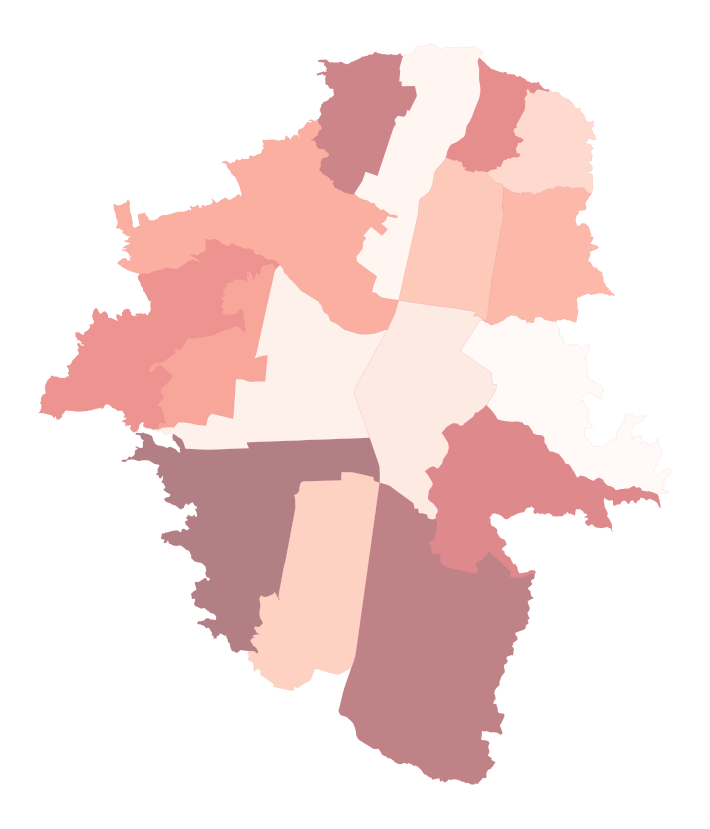

In [112]:
import matplotlib.pyplot as plt
figs = 15
fig, ax = plt.subplots(figsize=(figs, figs))

ax.set_aspect('equal')
gdf_pop_merge_agg.plot(ax=ax, alpha=0.5, edgecolor='#DC143C', linewidth=.1,column='diff', scheme='QUANTILES', k=20, cmap='Reds')#, legend=True)
plt.axis('off')
gdf_aoi_2018[gdf_aoi_2018['ndvi']==True].plot(ax=ax,hatch= ".", alpha=.5, edgecolor='#0e6b52', linewidth=.09, color='#0e6b52')
plt.show();

/usr/local/lib/python3.7/dist-packages/mapclassify/classifiers.py:235: UserWarning: Warning: Not enough unique values in array to form k classes
  "Warning: Not enough unique values in array to form k classes", UserWarning
/usr/local/lib/python3.7/dist-packages/mapclassify/classifiers.py:237: UserWarning: Warning: setting k to 13
  Warn("Warning: setting k to %d" % k_q, UserWarning)


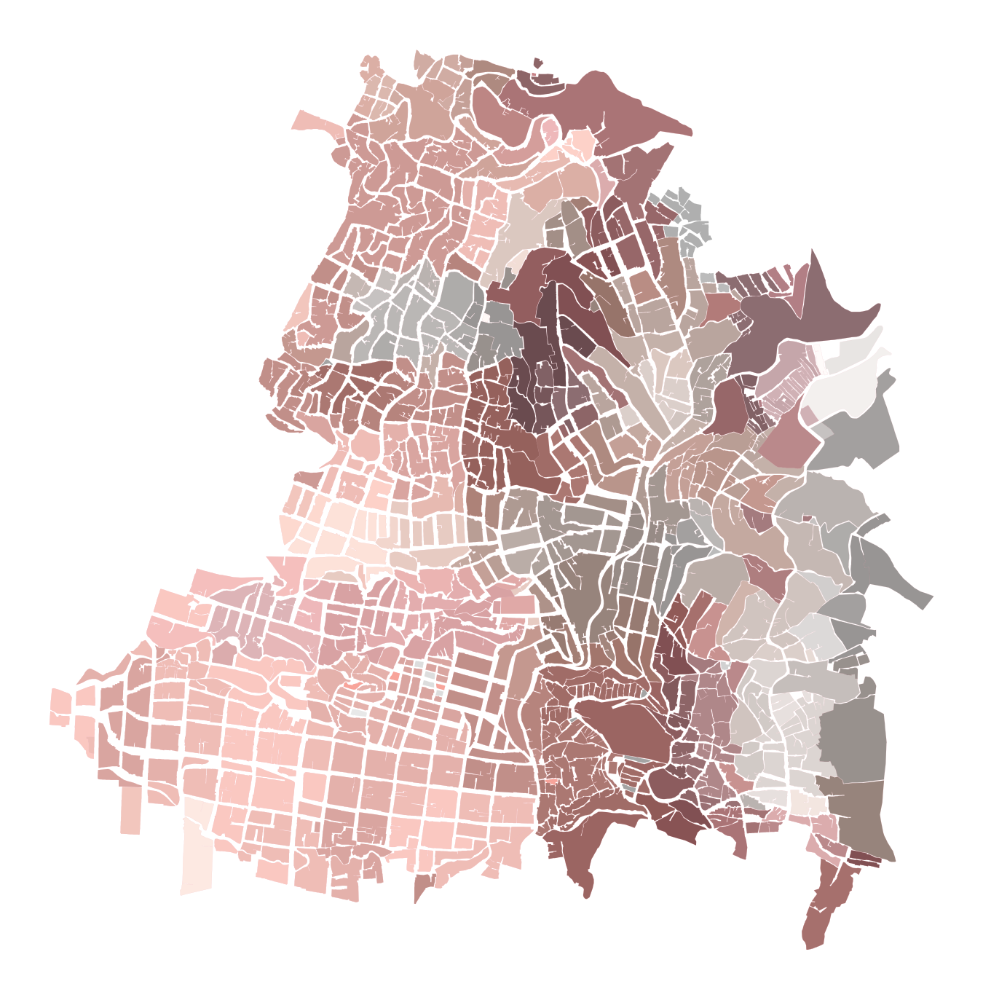

In [ ]:
import matplotlib.pyplot as plt
figs = 25
fig, ax = plt.subplots(figsize=(figs, figs))

ax.set_aspect('equal')
gdf_pop_merge_agg.plot(ax=ax, alpha=0.5, edgecolor='#DC143C', linewidth=.1,column='diff', scheme='QUANTILES', k=20, cmap='Reds')#, legend=True)
plt.axis('off')
#gdf_aoi[gdf_aoi['ndvi']==True].plot(ax=ax,hatch= ".", alpha=.5, edgecolor='#0e6b52', linewidth=.09, color='#0e6b52')
gdf_texture_aoi.plot(ax=ax, alpha=0.4, edgecolor='white', linewidth=.1,column='mean', scheme='QUANTILES', k=10, cmap='gray_r')
#[gdf_elev_aoi['mean']>1900]
plt.show();



### 2015

In [ ]:
wpop_2015_urb = wpop_2015.rename('pop').reduceRegions(collection= parcels,reducer=ee.Reducer.mean(), scale= 200)
geemap.ee_to_shp(wpop_2015_urb, 'medellin_parcels_pop_2015.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
An error occurred while downloading. 
 Retrying ...
Generating URL ...
Please wait ...
Data downloaded to /content/medellin_parcels_pop_2015.shp


In [ ]:
df_wpop_2015 = gpd.read_file('medellin_parcels_pop_2015.shp')
pip_mask_2015 = df_wpop_2015.within(medellin_aoi)
gdf_aoi_pop_2015 = df_wpop_2015.loc[pip_mask_2015].copy()

print(df_wpop_2015.shape,gdf_aoi_pop_2015.shape)

(907, 12) (907, 12)


(-75.5568647811761, -75.53358075376921, 6.281950339455257, 6.305494392267193)

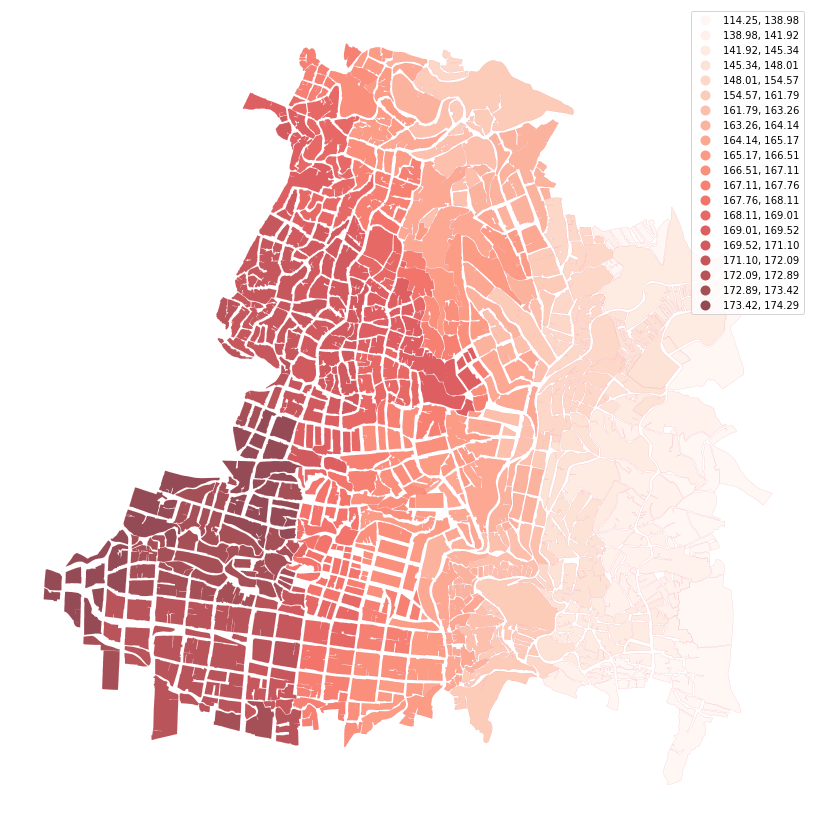

In [ ]:
figs = 15
plt = gdf_aoi_pop_2015.plot(figsize=(figs, figs), alpha=0.7, edgecolor='#DC143C', linewidth=.1,column='mean', scheme='QUANTILES', k=20, cmap='Reds', legend=True)
plt.axis('off')
#plt.gca().set_position([0, 0, 1, 1])

In [ ]:
from google.colab import files
plt.figure.savefig('medellin_pop_2015.png')
files.download('medellin_pop_2015.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Now

In [ ]:
wpop_2020_urb = wpop_2020.rename('pop').reduceRegions(collection= parcels,reducer=ee.Reducer.mean(), scale= 200)
geemap.ee_to_shp(wpop_2020_urb, 'medellin_parcels_pop_2020.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
An error occurred while downloading. 
 Retrying ...
Generating URL ...
Please wait ...
Data downloaded to /content/medellin_parcels_pop_2020.shp


In [ ]:
df_wpop_2020 = gpd.read_file('medellin_parcels_pop_2020.shp')
pip_mask_2020 = df_wpop_2020.within(medellin_aoi)
gdf_aoi_pop_2020 = df_wpop_2020.loc[pip_mask_2020].copy()

print(df_wpop_2020.shape,gdf_aoi_pop_2020.shape)

(907, 12) (907, 12)


(-75.5568647811761, -75.53358075376921, 6.281950339455257, 6.305494392267193)

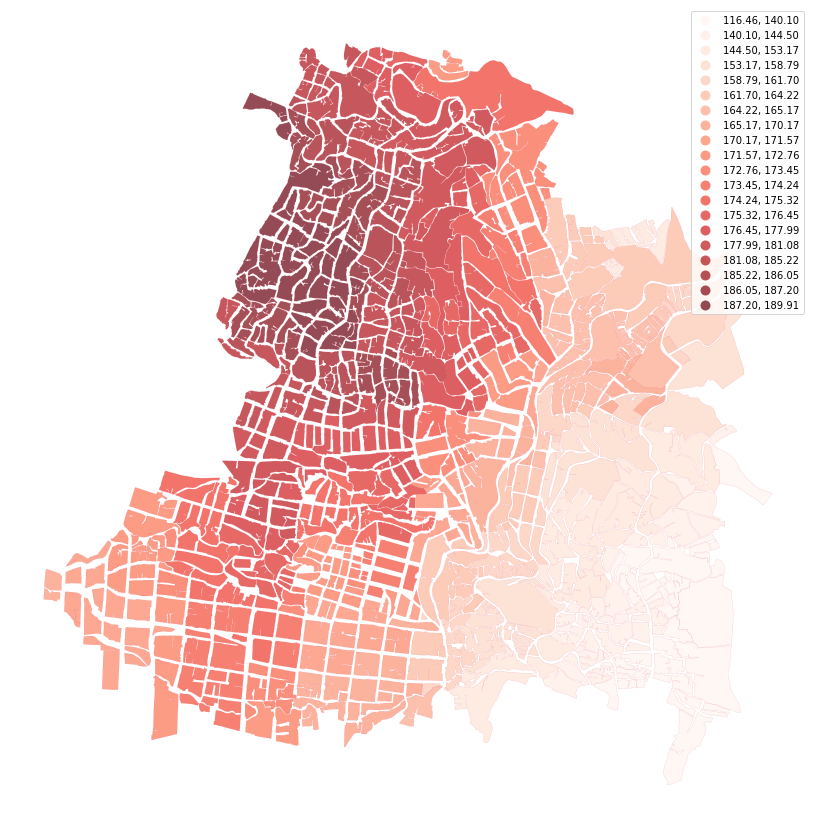

In [ ]:
figs = 15
plt = gdf_aoi_pop_2020.plot(figsize=(figs, figs), alpha=0.7, edgecolor='#DC143C', linewidth=.1,column='mean', scheme='QUANTILES', k=20, cmap='Reds', legend=True)
plt.axis('off')
#plt.gca().set_position([0, 0, 1, 1])

In [ ]:
from google.colab import files
plt.figure.savefig('medellin_pop_2020.png')
files.download('medellin_pop_2020.png') 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Change

In [ ]:
df_pop_from_agg = gdf_aoi_pop_2015.rename(columns={'mean':'pop_2015'})
df_pop_to_agg = gdf_aoi_pop_2020.rename(columns={'mean':'pop_2020'})

df_pop_merge_agg = df_pop_to_agg[['COD_RDTM','pop_2020']].merge(df_pop_from_agg, on='COD_RDTM')

#df_bu_merge_agg = gpd.sjoin(df_bu_to_agg[['COD_DANE','bu_2021']], df_bu_from_agg, how="inner", op='overlaps')

df_pop_merge_agg['diff'] = df_pop_merge_agg['pop_2020']  - (df_pop_merge_agg['pop_2015'])
df_pop_merge_agg[:1]

,COD_RDTM,pop_2020,SHAPE_LEN,COD_DPTO,COD_AG,COD_MPIO,COD_DANE,pop_2015,COD_CPOB,SHAPE_AREA,COD_CLASE,COD_SECC,geometry,diff
0,050011010000000001010101,173.454468,0.003371,05,000001,05001,0500110000000001010101,163.991486,05001000,2.313257e-07,1,05001100000000010101,"POLYGON ((-75.54288 6.30169, -75.54285 6.30171...",9.462982


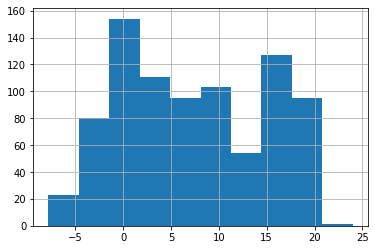

In [ ]:
df_pop_merge_agg['diff'].hist()

In [ ]:
import geopandas
gdf_pop_merge_agg = geopandas.GeoDataFrame(
    df_pop_merge_agg, geometry=df_pop_merge_agg.geometry)

gdf_pop_merge_agg = gdf_pop_merge_agg.set_crs(epsg=3857, inplace=True)

(-75.5568647811761, -75.53358075376921, 6.281950339455257, 6.305494392267193)

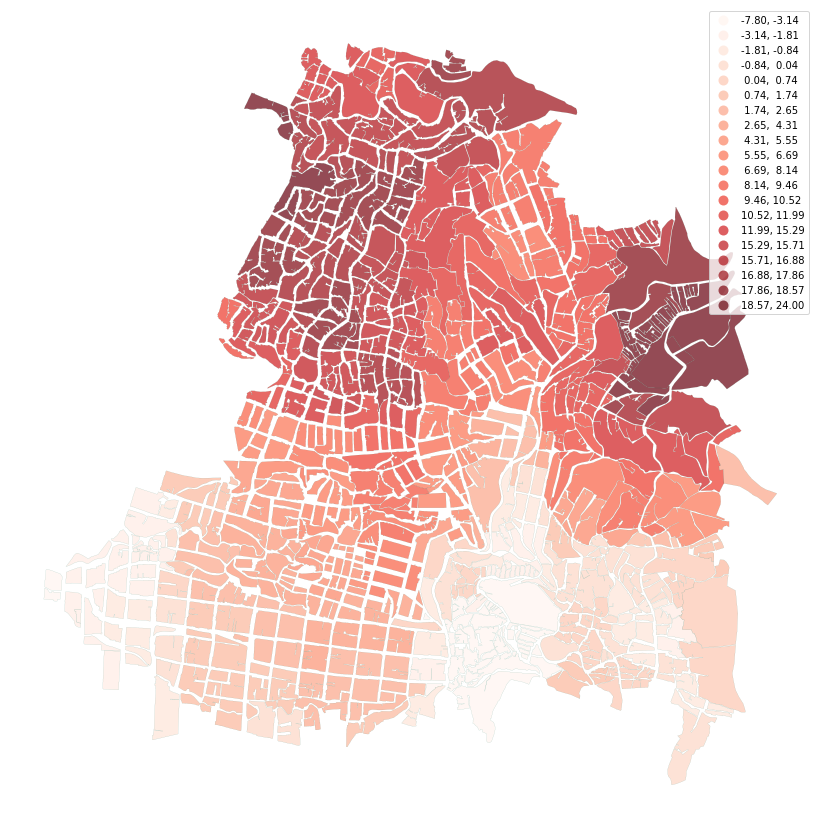

In [ ]:
figs = 15
plt = gdf_pop_merge_agg.plot(figsize=(figs, figs), alpha=0.7, edgecolor='#0e6b52', linewidth=.1,column='diff', scheme='QUANTILES', k=20, cmap='Reds', legend=True)
plt.set_label('build up percentage')
#plt.legend(loc="upper right")
plt.axis('off')

In [ ]:
from google.colab import files
plt.figure.savefig('medellin_pop_2015_2020.png')
files.download('medellin_pop_2015_2020.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

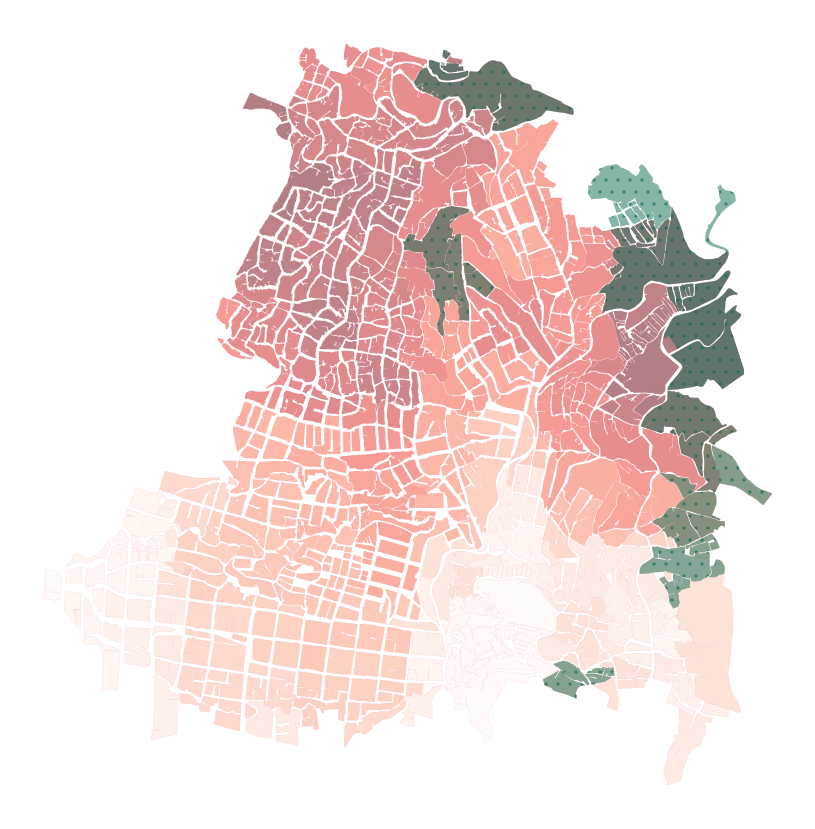

In [ ]:
import matplotlib.pyplot as plt
figs = 15
fig, ax = plt.subplots(figsize=(figs, figs))

ax.set_aspect('equal')
gdf_pop_merge_agg.plot(ax=ax, alpha=0.5, edgecolor='#DC143C', linewidth=.1,column='diff', scheme='QUANTILES', k=20, cmap='Reds')#, legend=True)
plt.axis('off')
gdf_aoi_2018[gdf_aoi_2018['ndvi']==True].plot(ax=ax,hatch= ".", alpha=.5, edgecolor='#0e6b52', linewidth=.09, color='#0e6b52')
plt.show();

In [ ]:
from google.colab import files
fig.savefig('medellin_pop_diff_green.png')
files.download('medellin_pop_diff_green.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

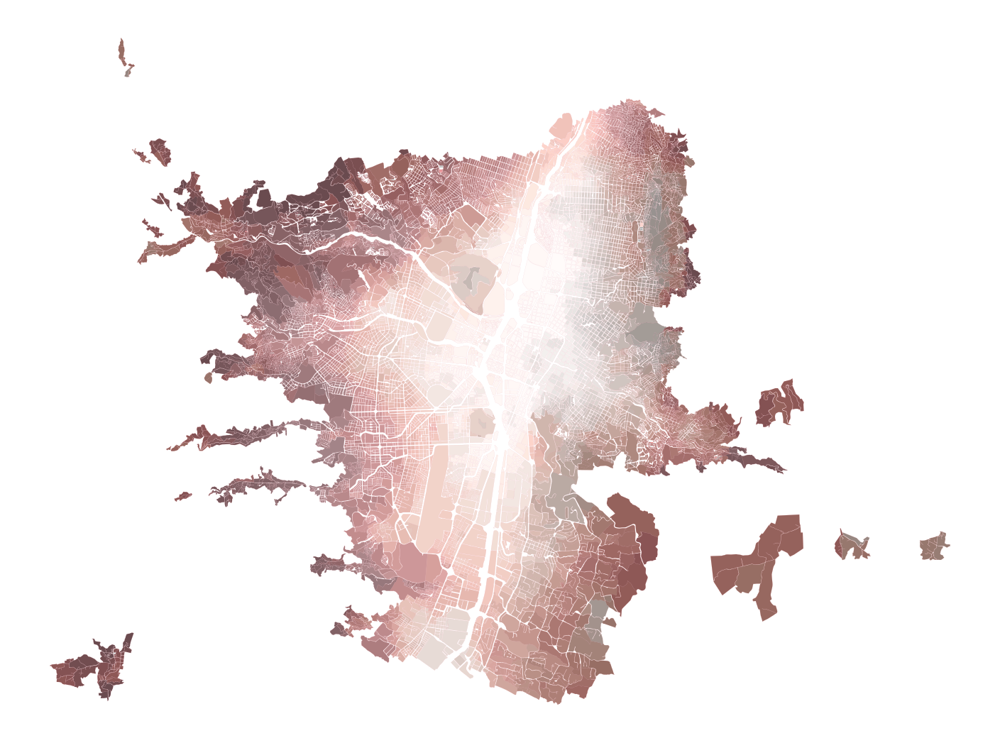

In [ ]:
import matplotlib.pyplot as plt
figs = 25
fig, ax = plt.subplots(figsize=(figs, figs))

ax.set_aspect('equal')
gdf_pop_merge_agg.plot(ax=ax, alpha=0.5, edgecolor='#DC143C', linewidth=.1,column='diff', scheme='QUANTILES', k=20, cmap='Reds')#, legend=True)
plt.axis('off')
#gdf_aoi[gdf_aoi['ndvi']==True].plot(ax=ax,hatch= ".", alpha=.5, edgecolor='#0e6b52', linewidth=.09, color='#0e6b52')
gdf_elev_aoi.plot(ax=ax, alpha=0.4, edgecolor='white', linewidth=.1,column='mean', scheme='QUANTILES', k=10, cmap='gray_r')
#[gdf_elev_aoi['mean']>1900]
plt.show();



In [ ]:
from google.colab import files
fig.savefig('medellin_pop_diff_elev.png')
files.download('medellin_pop_diff_elev.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Land Use Efficiency LUE!

### 1990-2015

In [ ]:
neighborhoods = ee.FeatureCollection("users/eriklehmann91/medellin_neighborhoods")\
                                    #.filter(ee.Filter.eq("name",'Comuna 1 - Popular'))  #Comuna 14 - El Poblado

In [ ]:
def print_perc(x):
    print(round(x*100,2),'%')

scale_senti = 200
V_present = TotalBuiltUp_2015.reduceRegion( ee.Reducer.sum(),med,scale= scale_senti,maxPixels=1e12).getInfo()['built']
V_past = TotalBuiltUp_1990.reduceRegion( ee.Reducer.sum(),med,scale= scale_senti,maxPixels=1e12).getInfo()['built']
T =  2015 - 1990

# UN stats recomendation
LCR_15 = (V_present - V_past)/V_past * 1/T
print_perc(LCR_15)
# We use logarithm to be consistent with population growth
LCR_15 = np.log(V_present/ V_past) * 1/T
print_perc(LCR_15)

import numpy as np
Pop_present = pop_2015.reduceRegion( ee.Reducer.sum(),med,scale= scale_senti,maxPixels=1e12).getInfo()['population_count_mean']
Pop_past = pop_2000.reduceRegion( ee.Reducer.sum(),med,scale= scale_senti,maxPixels=1e12).getInfo()['population_count_mean']
T =  2015 -2000

PGR_15 = (Pop_present - Pop_past)/Pop_past * 1/T
print_perc(PGR_15)
PGR_15 = np.log(Pop_present/ Pop_past) * 1/T
print_perc(PGR_15)

0.38 %
0.37 %
0.94 %
0.88 %


In [ ]:
LCRPGR_15 = LCR_15 / PGR_15
print_perc(LCRPGR_15)

41.7 %


In [365]:
LCR_15 = (TotalBuiltUp_2015.subtract(TotalBuiltUp_1990)).divide(TotalBuiltUp_1990).multiply((ee.Number(1).divide(ee.Number(25))))

In [366]:
PGR_15 = (pop_2015.subtract(pop_1990)).divide(pop_1990).multiply((ee.Number(1).divide(ee.Number(25))))

In [367]:
LCRPGR = LCR_15.divide(PGR_15)
LCRPGR.reduceRegion.reduceRegions(collection= parcels,reducer=ee.Reducer.mean(), scale= 200)

AttributeError: ignored

In [368]:
Y_90 = TotalBuiltUp_1990_area.select('1990').divide(pop_1990) #qm per person
Y_15 = TotalBuiltUp_2015_area.select('2015').divide(pop_2015) #

LUE_15 = (Y_90.subtract(Y_15)).divide(Y_90).multiply(ee.Number(10).divide(ee.Number(2015).subtract(ee.Number(1990))))


In [398]:
lue = LUE_15.rename('lue').reduceRegions(collection= AOI_level,reducer=ee.Reducer.mean(), scale=AOI_pixel)

In [399]:
geemap.ee_to_shp(lue, 'medellin_parcels_lue_90_15.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
Data downloaded to /content/medellin_parcels_lue_90_15.shp


In [400]:
label_df_lue_90_15 = gpd.read_file('medellin_parcels_lue_90_15.shp')

In [401]:
pip_mask = label_df_lue_90_15.within(medellin_aoi)
gdf_aoi_lue_90_15 = label_df_lue_90_15.loc[pip_mask].copy()

print(label_df_lue_90_15.shape,gdf_aoi_lue_90_15.shape)

(16, 6) (16, 6)


In [402]:
gdf_aoi_lue_90_15[:2]

,area,city,mean,name,admin_leve,geometry
0,32.441630,Medell?n,0.076557,Comuna 12 - La Am?rica,8,"POLYGON ((-75.61843 6.25217, -75.61821 6.25274..."
1,49.518716,Medell?n,0.050238,Comuna 5 - Castilla,8,"POLYGON ((-75.58037 6.28478, -75.58034 6.28495..."


(-75.6447057091541, -75.51564504764828, 6.168440119079672, 6.319695974571951)

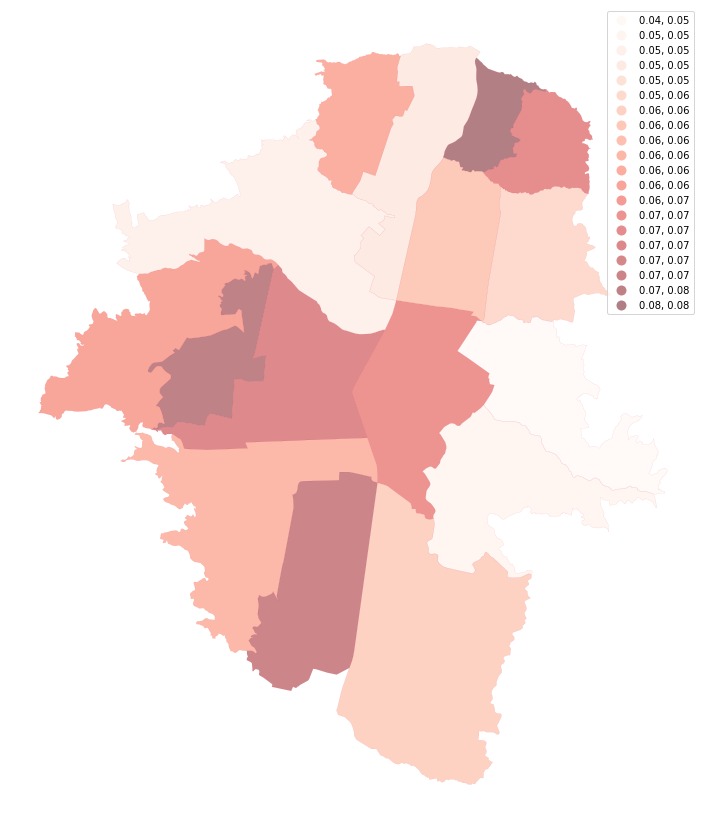

In [403]:
figs = 15
plt = gdf_aoi_lue_90_15.plot(figsize=(figs, figs), alpha=0.5, edgecolor='#DC143C', linewidth=.1,column='mean', scheme='QUANTILES', k=20, cmap='Reds', legend=True)
plt.axis('off')
#plt.gca().set_position([0, 0, 1, 1])

In [ ]:

from google.colab import files
plt.figure.savefig('medellin_lue_90_15.png')
files.download('medellin_lue_90_15.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### New

#### Change

In [322]:
df_pop_merge_agg[:2]

,COD_DANE,pop_2015,SHAPE_LEN,COD_DPTO,COD_AG,COD_MPIO,pop_1990,COD_RDTM,COD_CPOB,SHAPE_AREA,COD_CLASE,COD_SECC,geometry,diff,diff_abs
0,0500110000000001010101,1491.288199,0.003371,05,000001,05001,1362.229774,050011010000000001010101,05001000,2.313257e-07,1,05001100000000010101,"POLYGON ((-75.54288 6.30169, -75.54285 6.30171...",0.094671,129.058425
1,0500110000000001010104,1564.786987,0.002620,05,000002,05001,1423.271606,050011010000000001010104,05001000,1.629524e-07,1,05001100000000010101,"POLYGON ((-75.54262 6.29964, -75.54260 6.29965...",0.099360,141.515381


In [323]:
df_bu_merge_agg[:2]

,COD_DANE,bu_2015,2015,SHAPE_LEN,COD_DPTO,total,COD_AG,COD_MPIO,COD_RDTM,1990,COD_CPOB,SHAPE_AREA,COD_CLASE,COD_SECC,geometry,bu_1990,lcr
0,0500110000000001010101,0.999624,2660.432169,0.003371,05,2660.432169,000001,05001,050011010000000001010101,2660.432169,05001000,2.313257e-07,1,05001100000000010101,"POLYGON ((-75.54288 6.30169, -75.54285 6.30171...",0.999624,0.0
1,0500110000000001010104,0.999437,1773.635907,0.002620,05,1773.635907,000002,05001,050011010000000001010104,1773.635907,05001000,1.629524e-07,1,05001100000000010101,"POLYGON ((-75.54262 6.29964, -75.54260 6.29965...",0.999437,0.0


In [325]:
df_pop_merge_agg = df_pop_merge_agg.rename(columns={'diff_abs':'pgr'})
df_bu_merge_agg = df_bu_merge_agg.rename(columns={'diff':'lcr'})

df_pop_bu_merge_agg = df_pop_merge_agg[['COD_DANE','pgr']].merge(df_bu_merge_agg, on='COD_DANE')

#df_bu_merge_agg = gpd.sjoin(df_bu_to_agg[['COD_DANE','bu_2021']], df_bu_from_agg, how="inner", op='overlaps')

#df_pop_bu_merge_agg['lue_1990'] =  ((df_pop_bu_merge_agg['bu_1990']) / (df_pop_bu_merge_agg['pop_1990'] +.01)*1000
#df_pop_bu_merge_agg['lue_2015'] =  ((df_pop_bu_merge_agg['bu_2015']) / (df_pop_bu_merge_agg['pop_2015'] +1)*1000
df_pop_bu_merge_agg['lue_change'] = df_pop_bu_merge_agg['lcr'] / df_pop_bu_merge_agg['pgr']
#df_pop_bu_merge_agg['lue_change'] = (df_pop_bu_merge_agg['1990']  / (df_pop_bu_merge_agg['pop_1990']+1)) / ( df_pop_bu_merge_agg['2015'] /(df_pop_bu_merge_agg['pop_2015']+1) )
df_pop_bu_merge_agg['lue_change'] = df_pop_bu_merge_agg['lue_change'].apply(lambda x: min(x,2))
df_pop_bu_merge_agg[:1]

,COD_DANE,pgr,bu_2015,2015,SHAPE_LEN,COD_DPTO,total,COD_AG,COD_MPIO,COD_RDTM,1990,COD_CPOB,SHAPE_AREA,COD_CLASE,COD_SECC,geometry,bu_1990,lcr,lue_change
0,0500110000000001010101,129.058425,0.999624,2660.432169,0.003371,05,2660.432169,000001,05001,050011010000000001010101,2660.432169,05001000,2.313257e-07,1,05001100000000010101,"POLYGON ((-75.54288 6.30169, -75.54285 6.30171...",0.999624,0.0,0.0


In [326]:
df_bu_merge_agg[:2]

,COD_DANE,bu_2015,2015,SHAPE_LEN,COD_DPTO,total,COD_AG,COD_MPIO,COD_RDTM,1990,COD_CPOB,SHAPE_AREA,COD_CLASE,COD_SECC,geometry,bu_1990,lcr
0,0500110000000001010101,0.999624,2660.432169,0.003371,05,2660.432169,000001,05001,050011010000000001010101,2660.432169,05001000,2.313257e-07,1,05001100000000010101,"POLYGON ((-75.54288 6.30169, -75.54285 6.30171...",0.999624,0.0
1,0500110000000001010104,0.999437,1773.635907,0.002620,05,1773.635907,000002,05001,050011010000000001010104,1773.635907,05001000,1.629524e-07,1,05001100000000010101,"POLYGON ((-75.54262 6.29964, -75.54260 6.29965...",0.999437,0.0


In [338]:
df_pop_from_agg = gdf_aoi_pop_1990.rename(columns={'mean':'pop_1990'})
df_pop_to_agg = gdf_aoi_pop_2015.rename(columns={'mean':'pop_2015'})

df_pop_bu_merge_agg = df_pop_merge_agg[['COD_DANE','pop_2015','pop_1990']].merge(df_bu_merge_agg, on='COD_DANE')

#df_bu_merge_agg = gpd.sjoin(df_bu_to_agg[['COD_DANE','bu_2021']], df_bu_from_agg, how="inner", op='overlaps')

#df_pop_bu_merge_agg['lue_1990'] = (df_pop_bu_merge_agg['bu_1990']*df_pop_bu_merge_agg['total']) / ((df_pop_bu_merge_agg['pop_1990']+1)*df_pop_bu_merge_agg['total']) *1000
#df_pop_bu_merge_agg['lue_1990'][df_pop_bu_merge_agg['lue_1990']>3] = 3
#df_pop_bu_merge_agg['lue_2015'] = (df_pop_bu_merge_agg['bu_2015']*df_pop_bu_merge_agg['total']) / ((df_pop_bu_merge_agg['pop_2015']+1)*df_pop_bu_merge_agg['total'])*1000
#df_pop_bu_merge_agg['lue_2015'][df_pop_bu_merge_agg['lue_2015']>3] = 3

df_pop_bu_merge_agg['lue_1990'] = (df_pop_bu_merge_agg['pop_1990']*df_pop_bu_merge_agg['total']) / ((df_pop_bu_merge_agg['bu_1990'])*df_pop_bu_merge_agg['total']+1) #*1000
df_pop_bu_merge_agg['lue_1990'][df_pop_bu_merge_agg['bu_1990']<.2] = 1
df_pop_bu_merge_agg['lue_2015'] = (df_pop_bu_merge_agg['pop_2015']*df_pop_bu_merge_agg['total']) / ((df_pop_bu_merge_agg['bu_2015'])*df_pop_bu_merge_agg['total']+1) #*1000
df_pop_bu_merge_agg['lue_2015'][df_pop_bu_merge_agg['bu_2015']<.3] = 1
#df_pop_bu_merge_agg['lue_change'] = df_pop_bu_merge_agg['lue_1990'] / df_pop_bu_merge_agg['lue_2015']
df_pop_bu_merge_agg['lue_change'] = (df_pop_bu_merge_agg['bu_1990']  / (df_pop_bu_merge_agg['pop_1990']+1)) / ( df_pop_bu_merge_agg['bu_2015'] /(df_pop_bu_merge_agg['pop_2015']+1) )
df_pop_bu_merge_agg['lue_change'][df_pop_bu_merge_agg['bu_1990']<.05] = 1
df_pop_bu_merge_agg['lue_change'][df_pop_bu_merge_agg['bu_2015']<.3] = 1
df_pop_bu_merge_agg['lue_change'] = df_pop_bu_merge_agg['lue_change'].apply(lambda x: min(x,2))
df_pop_bu_merge_agg[:1]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: SettingWithCopyW

,COD_DANE,pop_2015,pop_1990,bu_2015,2015,SHAPE_LEN,COD_DPTO,total,COD_AG,COD_MPIO,COD_RDTM,1990,COD_CPOB,SHAPE_AREA,COD_CLASE,COD_SECC,geometry,bu_1990,lcr,lue_1990,lue_2015,lue_change
0,0500110000000001010101,1491.288199,1362.229774,0.999624,2660.432169,0.003371,05,2660.432169,000001,05001,050011010000000001010101,2660.432169,05001000,2.313257e-07,1,05001100000000010101,"POLYGON ((-75.54288 6.30169, -75.54285 6.30171...",0.999624,0.0,1362.229581,1491.287988,1.094671


In [339]:
df_pop_bu_merge_agg['lue_1990'] = df_pop_bu_merge_agg['lue_1990'].apply(lambda x: round(x,0))
df_pop_bu_merge_agg['lue_2015'] = df_pop_bu_merge_agg['lue_2015'].apply(lambda x: round(x,0))
#df_pop_bu_merge_agg['lue_1990'] = df_pop_bu_merge_agg['lue_1990'].apply(lambda x: round(x,0))


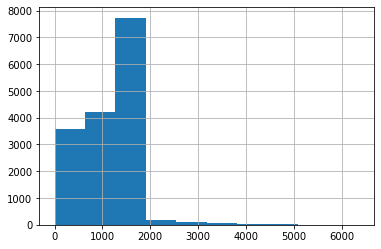

In [340]:
df_pop_bu_merge_agg['lue_1990'].hist()

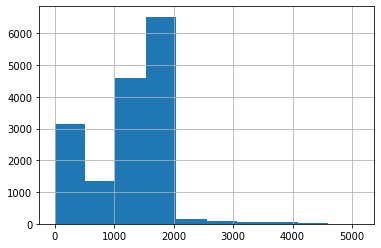

In [341]:
df_pop_bu_merge_agg['lue_2015'].hist()

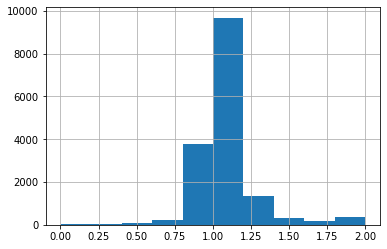

In [342]:
df_pop_bu_merge_agg['lue_change'].hist()

In [343]:
import geopandas
gdf_pop_bu_merge_agg = geopandas.GeoDataFrame(
    df_pop_bu_merge_agg, geometry=df_pop_bu_merge_agg.geometry)

gdf_pop_bu_merge_agg = gdf_pop_bu_merge_agg.set_crs(epsg=3857, inplace=True)

In [344]:
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
viridis = cm.get_cmap('Reds', 256)
newcolors = viridis(np.linspace(0, 1, 256))
pink = np.array([200/256, 200/256, 200/256, 1]) # 	65, 89, 150
newcolors[:25, :] = pink
newcmp = ListedColormap(newcolors)

(-75.66011035656898, -75.5033217358933, 6.166306199889512, 6.335666505588572)

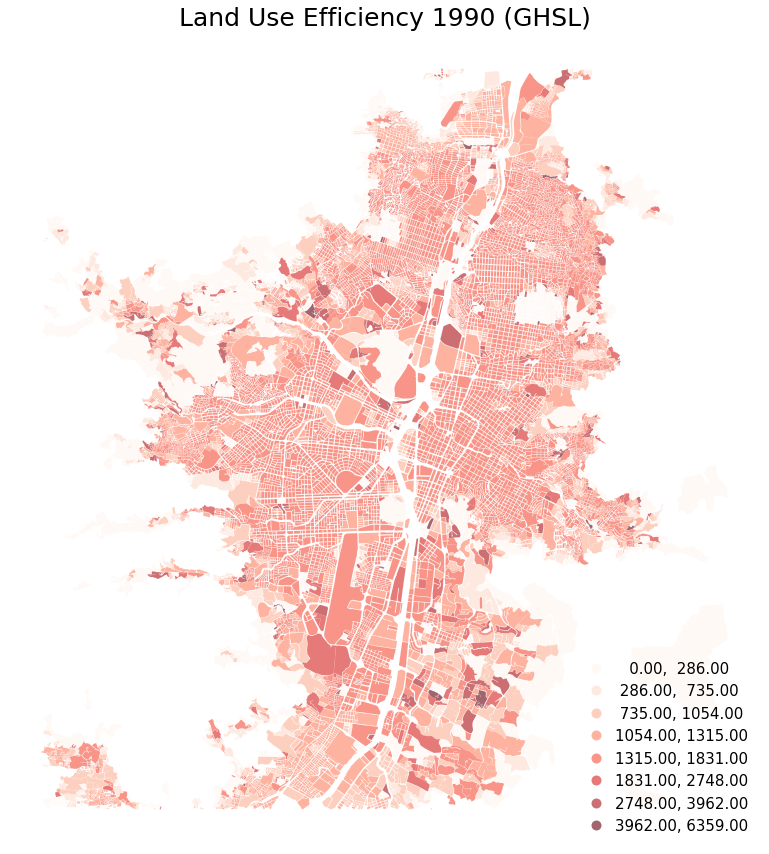

In [345]:
figs = 15
plt = gdf_pop_bu_merge_agg.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#ffffff',
                             linewidth=.1,
                             column='lue_1990',
                             scheme='NaturalBreaks',#'QUANTILES',
                             k=8,
                             cmap='Reds', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Land Use Efficiency 1990 (GHSL)", fontsize=25)
plt.axis('off')

(-75.66011035656898, -75.5033217358933, 6.166306199889512, 6.335666505588572)

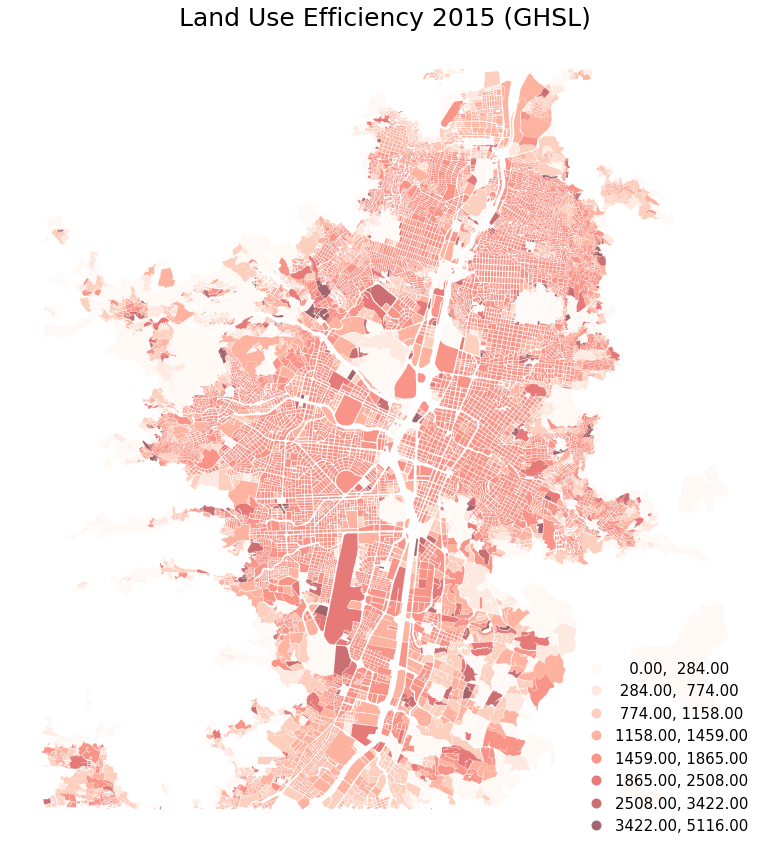

In [346]:
figs = 15
plt = gdf_pop_bu_merge_agg.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#ffffff',
                             linewidth=.1,
                             column='lue_2015',
                             scheme='NaturalBreaks',#'QUANTILES',
                             k=8,
                             cmap='Reds', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Land Use Efficiency 2015 (GHSL)", fontsize=25)
plt.axis('off')

(-75.66011035656898, -75.5033217358933, 6.166306199889512, 6.335666505588572)

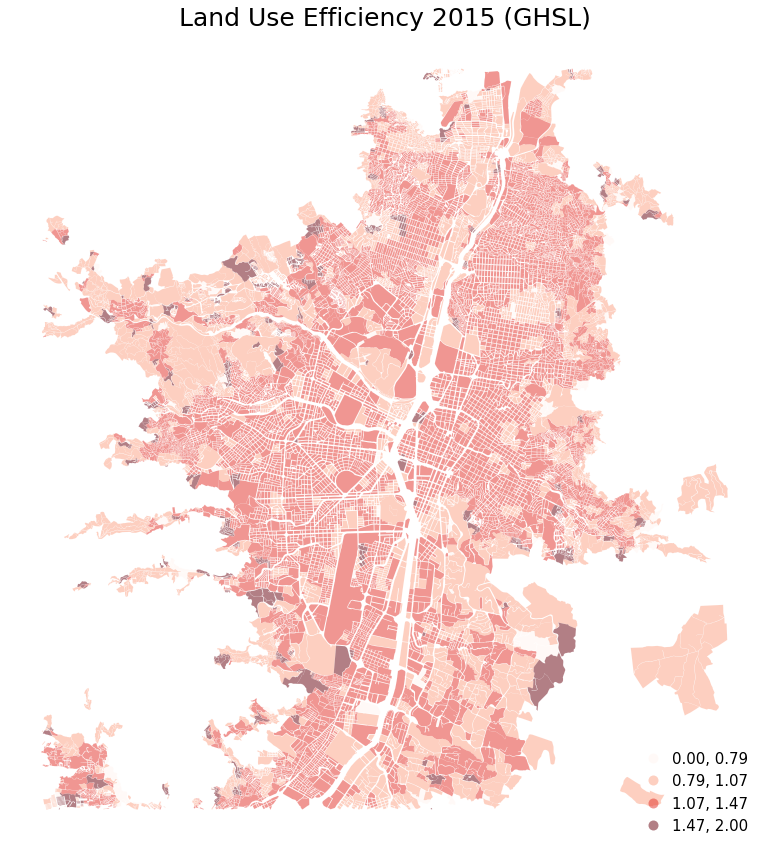

In [349]:
figs = 15
plt = gdf_pop_bu_merge_agg.plot(figsize=(figs, figs),
                             alpha=0.5,
                             edgecolor='#ffffff',
                             linewidth=.1,
                             column='lue_change',
                             scheme='NaturalBreaks',#'QUANTILES',
                             k=4,
                             cmap='Reds', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Land Use Efficiency 2015 (GHSL)", fontsize=25)
plt.axis('off')

In [308]:
gdf_neighborhoods = gpd.read_file('medellin_neighborhoods.shp')

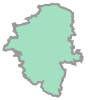

In [309]:
import fiona
from shapely.ops import cascaded_union
from shapely.geometry import shape

shape_fio = fiona.open("medellin_neighborhoods.shp")

#shp_geom = shape(shape['geometry']) # or shp_geom = shape(first) with PyShp)
shape_neigbor = cascaded_union([shape(s['geometry'])for s in shape_fio])
shape_neigbor

In [313]:
#df_wpop_1990 = gpd.read_file('medellin_parcels_pop_1990.shp')
#pip_mask_1990 = gdf_neighborhoods.contains(gdf_pop_bu_merge_agg)
pip_mask_1990 = gdf_pop_bu_merge_agg.within(shape_neigbor)
gdf_pop_bu_merge_agg['mask'] = pip_mask_1990  *-1 +1
#gdf_aoi_pop_1990 = df_wpop_1990.loc[pip_mask_1990].copy()

#print(df_wpop_1990.shape,gdf_aoi_pop_1990.shape)
gdf_pop_bu_merge_agg[:4]

,COD_DANE,pop_2015,pop_1990,bu_2015,2015,SHAPE_LEN,COD_DPTO,total,COD_AG,COD_MPIO,COD_RDTM,1990,COD_CPOB,SHAPE_AREA,COD_CLASE,COD_SECC,geometry,bu_1990,lcr,lue_1990,lue_2015,lue_change,mask
0,0500110000000001010101,1491.288199,1362.229774,0.999624,2660.432169,0.003371,05,2660.432169,000001,05001,050011010000000001010101,2660.432169,05001000,2.313257e-07,1,05001100000000010101,"POLYGON ((-75.54288 6.30169, -75.54285 6.30171...",0.999624,0.0,1362.0,1491.0,1.094671,0
1,0500110000000001010104,1564.786987,1423.271606,0.999437,1773.635907,0.002620,05,1773.635907,000002,05001,050011010000000001010104,1773.635907,05001000,1.629524e-07,1,05001100000000010101,"POLYGON ((-75.54262 6.29964, -75.54260 6.29965...",0.999437,0.0,1423.0,1565.0,1.099360,0
2,0500110000000001010105,1062.797963,837.044530,0.999549,2217.044884,0.003002,05,2217.044884,000003,05001,050011010000000001010105,2217.044884,05001000,2.090910e-07,1,05001100000000010101,"POLYGON ((-75.54320 6.29941, -75.54316 6.29944...",0.999549,0.0,837.0,1063.0,1.269381,0
3,0500110000000001010108,1377.661621,1282.982910,0.999590,2438.749372,0.001944,05,2438.749372,000004,05001,050011010000000001010108,2438.749372,05001000,1.573086e-07,1,05001100000000010101,"POLYGON ((-75.54391 6.29989, -75.54391 6.29990...",0.999590,0.0,1283.0,1378.0,1.073738,0


In [173]:
#gdf_pop_bu_merge_agg['lue_change_out'] = gdf_pop_bu_merge_agg['mask'] * gdf_pop_bu_merge_agg['lue_change']

In [311]:
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
viridis = cm.get_cmap('Reds', 256)
newcolors = viridis(np.linspace(0, 1, 256))
pink = np.array([179/256, 179/256, 179/256, 1]) # 	220,20,60
pink_ = np.array([209/256, 209/256, 209/256, 1]) # 	220,20,60
newcolors[:25, :] = pink
newcolors[25:45, :] = pink_
newreds = ListedColormap(newcolors)

AttributeError: ignored

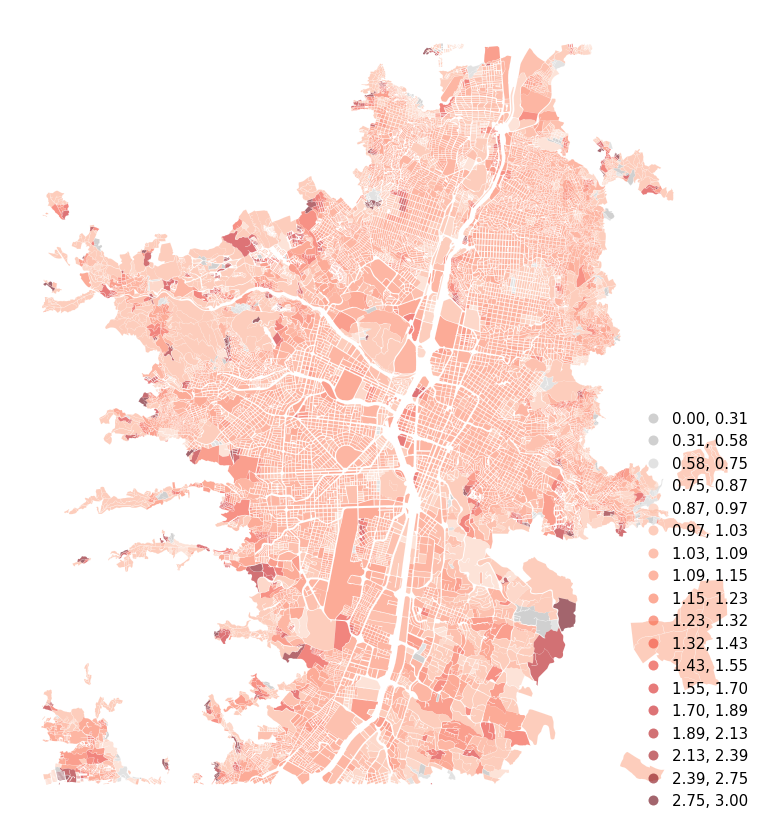

In [336]:
figs = 15
plt = gdf_pop_bu_merge_agg.plot(figsize=(figs, figs),
                                          alpha=0.6,
                                          edgecolor='#ffffff',
                                          linewidth=.1,
                                          column='lue_change',
                                          scheme='NaturalBreaks',#'QUANTILES',
                                          k=18,
                                          cmap=newreds,#'Reds', 
                                          legend=True,
                                          legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})
plt.axis('off')
plt.show();

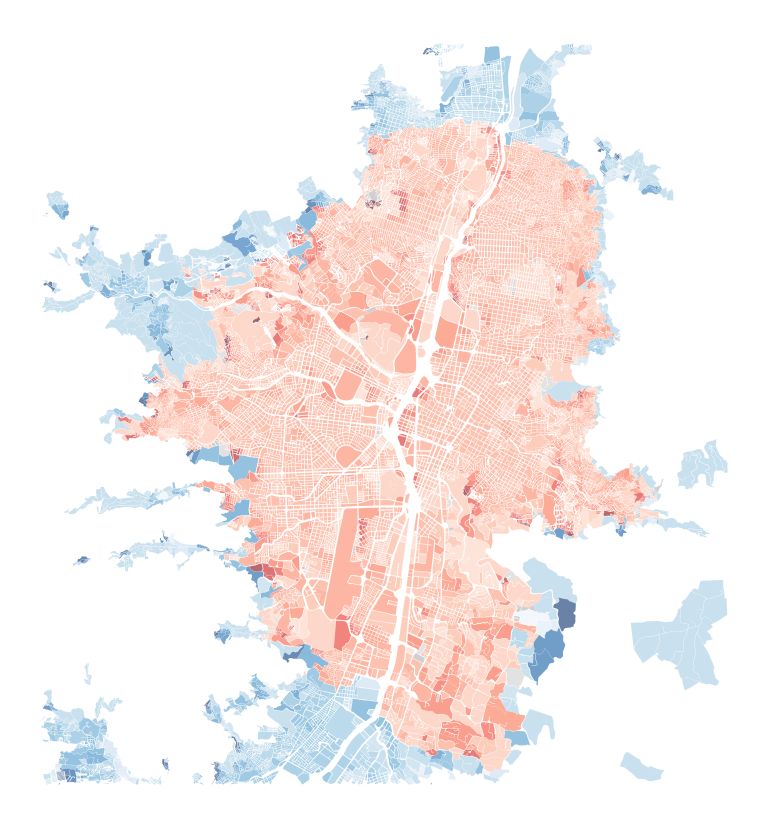

In [314]:
import matplotlib.pyplot as plt
figs = 15
fig, ax = plt.subplots(figsize=(figs, figs))

ax.set_aspect('equal')
#gdf_pop_merge_agg.plot(ax=ax, alpha=0.5, edgecolor='#DC143C', linewidth=.1,column='diff', scheme='QUANTILES', k=20, cmap='Reds')#, legend=True)
gdf_pop_bu_merge_agg[gdf_pop_bu_merge_agg['mask']==0].plot(ax=ax,
                                          alpha=0.6,
                                          edgecolor='#ffffff',
                                          linewidth=.1,
                                          column='lue_change',
                                          scheme='NaturalBreaks',#'QUANTILES',
                                          k=18,
                                          cmap=newreds,#'Reds', 
                                          #legend=True,
                                          legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})
gdf_pop_bu_merge_agg[gdf_pop_bu_merge_agg['mask']==1].plot(ax=ax,
                                          alpha=0.6,
                                          edgecolor='#ffffff',
                                          linewidth=.1,
                                          column='lue_change',
                                          scheme='NaturalBreaks',#'QUANTILES',
                                          k=18,
                                          cmap='Blues',#'Reds', 
                                          #legend=True,
                                          legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})
plt.axis('off')
plt.show();

(-75.65268149477583, -75.50737052961728, 6.166251187536097, 6.3262280706718395)

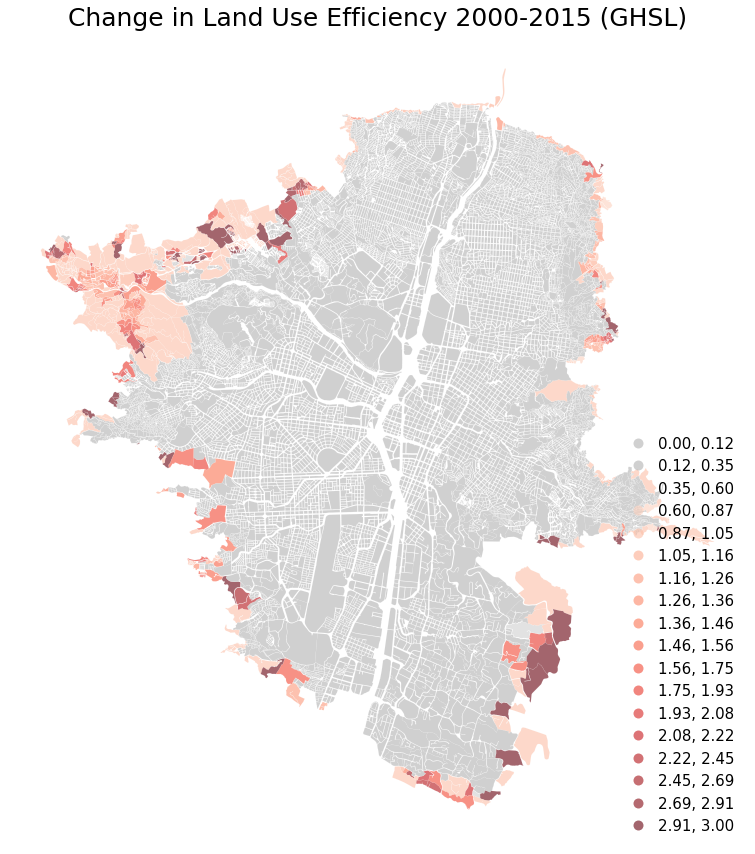

In [174]:
figs = 15
plt = gdf_pop_bu_merge_agg.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#ffffff',
                             linewidth=.1,
                             column='lue_change_out',
                             scheme='NaturalBreaks',#'QUANTILES',
                             k=18,
                             cmap=newreds,#'Reds', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Change in Land Use Efficiency 2000-2015 (GHSL)", fontsize=25)
plt.axis('off')

(-75.6447057091541, -75.51564504764828, 6.168440119079672, 6.319695974571951)

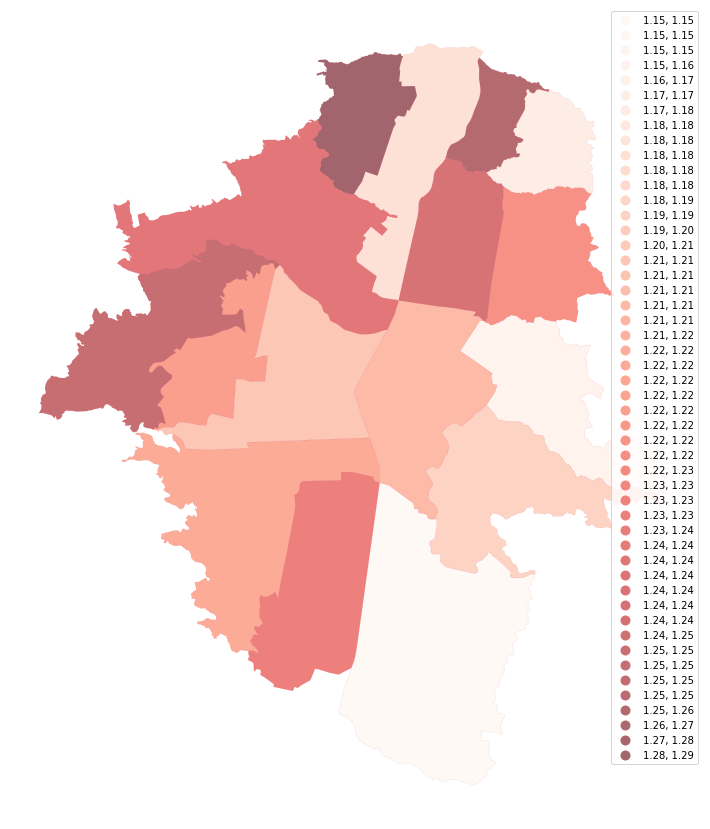

In [462]:
figs = 15
plt = gdf_pop_bu_merge_agg.plot(figsize=(figs, figs), alpha=0.6, edgecolor='#DC143C', linewidth=.1,column='lue_change', scheme='QUANTILES', k=50, cmap='Reds', legend=True)
plt.axis('off')
#plt.gca().set_position([0, 0, 1, 1])

In [ ]:

from google.colab import files
plt.figure.savefig('medellin_lue_90_15.png')
files.download('medellin_lue_90_15.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### 2015-2020

In [ ]:
Y_15 = builtUpPoP_2015.divide(wpop_2015) #qm per person
Y_20 = builtUpPoP_2020.divide(wpop_2020) #

LUE_15 = (Y_15.subtract(Y_20)).divide(Y_15).multiply(ee.Number(10).divide(ee.Number(2020).subtract(ee.Number(2015))))


In [ ]:
TotalBuiltUp_1990_area = TotalBuiltUp_1990.multiply(ee.Image.pixelArea())#.divide(1000000)
TotalBuiltUp_2015_area = TotalBuiltUp_2015.multiply(ee.Image.pixelArea())#.divide(1000000)

Y_15 = TotalBuiltUp_1990_area.divide(pop_1990) #qm per person
Y_20 = TotalBuiltUp_2015_area.divide(pop_2015) #

LUE_15 = (Y_15.subtract(Y_20)).divide(Y_15).multiply(ee.Number(10).divide(ee.Number(2015).subtract(ee.Number(1990))))


In [ ]:
lue = LUE_15.rename('lue').reduceRegions(collection= neighborhoods,reducer=ee.Reducer.mean(), scale= 200)

In [ ]:
geemap.ee_to_shp(lue, 'medellin_parcels_lue.shp', selectors=None, verbose=True, keep_zip=False) 

Generating URL ...
Please wait ...
Data downloaded to /content/medellin_parcels_lue.shp


In [ ]:
label_df_lue = gpd.read_file('medellin_parcels_lue.shp')

In [ ]:
pip_mask = label_df_lue.within(medellin_aoi)
gdf_aoi_lue = label_df_lue.loc[pip_mask].copy()

print(label_df_lue.shape,gdf_aoi_lue.shape)

(16, 5) (16, 5)


In [ ]:
label_df_lue[:2]

,area,city,name,admin_leve,geometry
0,32.441630,Medell?n,Comuna 12 - La Am?rica,8,"POLYGON ((-75.61843 6.25217, -75.61821 6.25274..."
1,49.518716,Medell?n,Comuna 5 - Castilla,8,"POLYGON ((-75.58037 6.28478, -75.58034 6.28495..."


KeyError: ignored

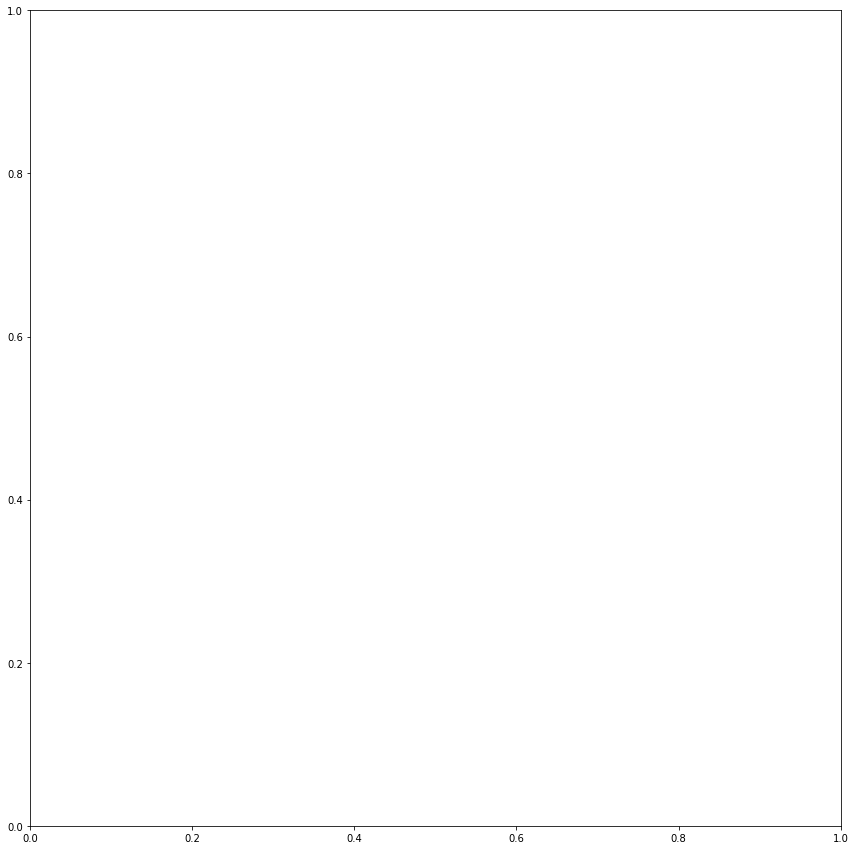

In [ ]:
figs = 15
plt = gdf_aoi_lue.plot(figsize=(figs, figs),
                             alpha=0.6,
                             edgecolor='#ffffff',
                             linewidth=.7,
                             column='mean',
                             scheme='QUANTILES',
                             k=8,
                             cmap='Reds', 
                             legend=True,
                             legend_kwds={'loc': 'lower right','fontsize': 15,'frameon':False,'handlelength':1})

plt.set_title("Change in Land Use Efficiency 1990-2015(GHSL)", fontsize=25)
plt.axis('off')

(-75.68313646313652, -75.46907203446717, 6.168560297017044, 6.3261975273422095)

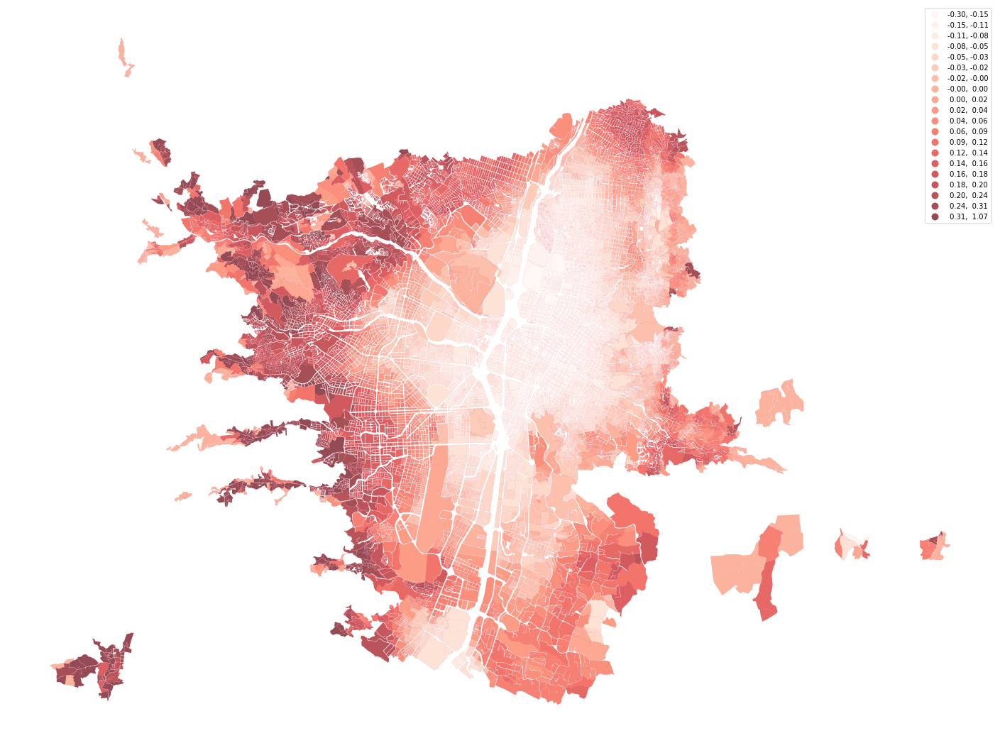

In [ ]:
figs = 25
plt = gdf_aoi_lue.plot(figsize=(figs, figs), alpha=0.7, edgecolor='#DC143C', linewidth=.1,column='mean', scheme='QUANTILES', k=20, cmap='Reds', legend=True)
plt.axis('off')
#plt.gca().set_position([0, 0, 1, 1])

In [ ]:
from google.colab import files
plt.figure.savefig('medellin_lue_2020.png')
files.download('medellin_lue_2020.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

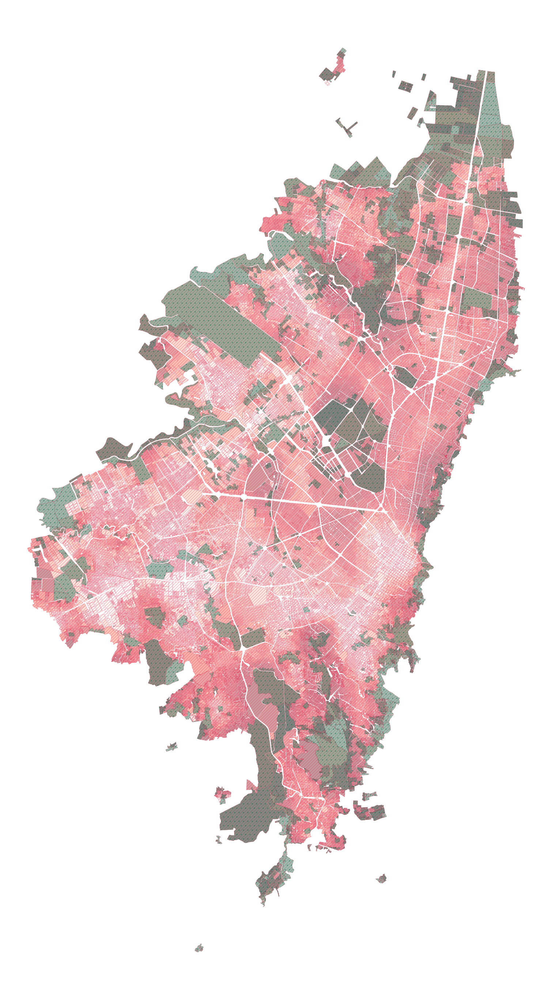

In [ ]:
import matplotlib.pyplot as plt
figs = 50
fig, ax = plt.subplots(figsize=(figs, figs))

ax.set_aspect('equal')
gdf_aoi_lue.plot(ax=ax, alpha=0.4,hatch= "///", edgecolor='#DC143C', linewidth=.7,column='mean', scheme='QUANTILES', k=20, cmap='Reds')#, legend=True)
plt.axis('off')
gdf_aoi[gdf_aoi['ndvi']==True].plot(ax=ax,hatch= ".", alpha=.4, edgecolor='#0e6b52', linewidth=.09, color='#0e6b52')
plt.show();

In [ ]:
from google.colab import files
fig.savefig('columbia_lue_2020_green.png')
files.download('columbia_lue_2020_green.png') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

GEE Service Account

In [ ]:
planet-gee-uploader@planet-earthengine-staging.iam.gserviceaccount.com